In [135]:
# importing necessary libraries
import warnings
import pandas as pd
import tensorflow as tf
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
from scipy.stats import pearsonr
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score
import statsmodels.api as sm
from sklearn.cluster import KMeans
from statsmodels.stats.outliers_influence import variance_inflation_factor
from xgboost import XGBRegressor
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.feature_selection import RFE
from sklearn.feature_selection import RFECV
#from tensorflow.keras.wrappers.scikit_learn import KerasRegressor
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import Ridge
from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam
warnings.filterwarnings('ignore')

In [136]:
!pip install xgboost


In [137]:
!pip install tensorflow

In [138]:
# loading the dataset
Price = pd.read_excel('Median_House_price_1.xlsx') # median house price dataset  
factor = pd.read_excel('Deprivation_House_Price_2.xlsx') # deprivation indices

In [139]:
# Checking the dataset
Price.head(10)

,Local authority code,Local authority name,LSOA code,LSOA name,Price
0,E06000001,Hartlepool,E01011949,Hartlepool 009A,34750
1,E06000001,Hartlepool,E01011950,Hartlepool 008A,25000
2,E06000001,Hartlepool,E01011951,Hartlepool 007A,27000
3,E06000001,Hartlepool,E01011952,Hartlepool 002A,44500
4,E06000001,Hartlepool,E01011953,Hartlepool 002B,22000
5,E06000001,Hartlepool,E01011954,Hartlepool 001A,29125
6,E06000001,Hartlepool,E01011955,Hartlepool 003A,30000
7,E06000001,Hartlepool,E01011957,Hartlepool 003C,24500
8,E06000001,Hartlepool,E01011959,Hartlepool 014A,69000
9,E06000001,Hartlepool,E01011960,Hartlepool 014B,54000


In [140]:
# Checking the dataset
factor.head(10)

,LSOA code (2011),LSOA name (2011),Local Authority District code (2013),Local Authority District name (2013),Index of Multiple Deprivation (IMD) Score,Income Score (rate),Employment Score (rate),"Education, Skills and Training Score",Health Deprivation and Disability Score,Crime Score,Barriers to Housing and Services Score,Living Environment Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate),Children and Young People Sub-domain Score,Adult Skills Sub-domain Score,Geographical Barriers Sub-domain Score,Wider Barriers Sub-domain Score,Indoors Sub-domain Score,Outdoors Sub-domain Score
0,E01031349,Adur 001A,E07000223,Adur,12.389,0.096,0.083,20.055,-0.718,0.242,10.586,15.180,0.143,0.103,0.098,0.333,-0.346,-0.721,-0.268,0.312
1,E01031350,Adur 001B,E07000223,Adur,28.619,0.187,0.162,34.653,0.722,0.244,24.689,17.837,0.211,0.269,0.470,0.426,0.234,1.104,0.016,0.234
2,E01031351,Adur 001C,E07000223,Adur,11.713,0.065,0.066,26.334,-0.616,0.495,13.631,11.150,0.077,0.079,0.395,0.357,0.035,-1.048,-0.628,0.208
3,E01031352,Adur 001D,E07000223,Adur,16.446,0.117,0.113,25.779,-0.234,0.026,17.803,10.677,0.210,0.087,0.348,0.359,0.233,-0.596,-0.576,0.109
4,E01031370,Adur 001E,E07000223,Adur,18.265,0.102,0.115,32.056,0.082,0.182,15.482,15.378,0.117,0.131,0.840,0.338,-0.083,-0.086,-0.256,0.321
5,E01031374,Adur 001F,E07000223,Adur,12.529,0.072,0.084,14.261,-0.183,0.128,15.696,22.053,0.060,0.091,-0.257,0.309,-0.052,-0.118,0.307,0.194
6,E01031338,Adur 002A,E07000223,Adur,7.031,0.063,0.062,8.597,-0.241,-0.565,8.463,11.207,0.065,0.082,-0.294,0.229,-0.426,-1.221,-0.726,0.289
7,E01031339,Adur 002B,E07000223,Adur,6.791,0.072,0.054,3.882,-0.472,-1.473,19.940,13.118,0.134,0.063,-0.915,0.204,0.512,-1.431,-0.535,0.353
8,E01031340,Adur 002C,E07000223,Adur,7.345,0.036,0.041,13.214,-0.675,0.334,16.057,12.964,0.042,0.055,-0.046,0.267,0.406,-2.461,-0.874,0.552
9,E01031365,Adur 002D,E07000223,Adur,15.282,0.129,0.100,11.720,-0.016,0.268,10.279,17.965,0.149,0.150,-0.029,0.239,-0.691,-0.154,-0.127,0.440


In [141]:
# Checking dataset info
Price.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32844 entries, 0 to 32843
Data columns (total 5 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Local authority code  32844 non-null  object
 1   Local authority name  32844 non-null  object
 2   LSOA code             32844 non-null  object
 3   LSOA name             32844 non-null  object
 4   Price                 32844 non-null  object
dtypes: object(5)
memory usage: 1.3+ MB


In [142]:
# Checking dataset info
factor.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32844 entries, 0 to 32843
Data columns (total 20 columns):
 #   Column                                                            Non-Null Count  Dtype  
---  ------                                                            --------------  -----  
 0   LSOA code (2011)                                                  32844 non-null  object 
 1   LSOA name (2011)                                                  32844 non-null  object 
 2   Local Authority District code (2013)                              32844 non-null  object 
 3   Local Authority District name (2013)                              32844 non-null  object 
 4   Index of Multiple Deprivation (IMD) Score                         32844 non-null  float64
 5   Income Score (rate)                                               32844 non-null  float64
 6   Employment Score (rate)                                           32844 non-null  float64
 7   Education, Skills and Training 

In [143]:
# Checking for null values#No missing value
Price.isnull().sum()

Local authority code    0
Local authority name    0
LSOA code               0
LSOA name               0
Price                   0
dtype: int64

In [144]:
# Checking for null values 
factor.isnull().sum()

LSOA code (2011)                                                    0
LSOA name (2011)                                                    0
Local Authority District code (2013)                                0
Local Authority District name (2013)                                0
Index of Multiple Deprivation (IMD) Score                           0
Income Score (rate)                                                 0
Employment Score (rate)                                             0
Education, Skills and Training Score                                0
Health Deprivation and Disability Score                             0
Crime Score                                                         0
Barriers to Housing and Services Score                              0
Living Environment Score                                            0
Income Deprivation Affecting Children Index (IDACI) Score (rate)    0
Income Deprivation Affecting Older People (IDAOPI) Score (rate)     0
Children and Young P

In [145]:
# dataset summary
Price.describe()

,Local authority code,Local authority name,LSOA code,LSOA name,Price
count,32844,32844,32844,32844,32844
unique,311,309,32844,32844,3292
top,E08000025,Birmingham,E01011949,Hartlepool 009A,:
freq,639,639,1,1,1501


In [146]:
# dataset summary
factor.describe()

,Index of Multiple Deprivation (IMD) Score,Income Score (rate),Employment Score (rate),"Education, Skills and Training Score",Health Deprivation and Disability Score,Crime Score,Barriers to Housing and Services Score,Living Environment Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate),Children and Young People Sub-domain Score,Adult Skills Sub-domain Score,Geographical Barriers Sub-domain Score,Wider Barriers Sub-domain Score,Indoors Sub-domain Score,Outdoors Sub-domain Score
count,32844.000000,32844.000000,32844.000000,32844.000000,32844.000000,3.284400e+04,32844.000000,32844.000000,32844.000000,32844.000000,3.284400e+04,32844.000000,32844.000000,32844.000000,32844.000000,32844.000000
mean,21.669393,0.145229,0.119137,21.691083,0.000001,-8.829619e-07,21.691084,21.691082,0.184518,0.185661,1.826818e-07,0.306776,0.000002,-0.001579,0.000002,0.000002
std,15.593983,0.103141,0.076798,18.530861,0.891096,7.814165e-01,10.567243,15.941935,0.134476,0.126926,8.000562e-01,0.113524,0.792625,2.413483,0.862612,0.852799
min,0.477000,0.005000,0.003000,0.006000,-3.329000,-3.227000e+00,0.439000,0.151000,0.004000,0.007000,-2.861000e+00,0.031000,-2.925000,-9.060000,-3.429000,-3.839000
25%,9.652000,0.065000,0.062000,7.390000,-0.610250,-5.590000e-01,13.706000,9.032000,0.075000,0.088000,-5.560000e-01,0.224000,-0.533000,-1.703000,-0.591000,-0.586000
50%,17.398000,0.114000,0.097000,16.291500,-0.020000,7.000000e-03,20.288500,17.569500,0.148000,0.150000,-1.300000e-02,0.296000,-0.038000,-0.177000,0.007000,-0.021000
75%,30.066500,0.202000,0.158000,30.967000,0.603000,5.590000e-01,28.165000,31.053750,0.270000,0.253000,5.450000e-01,0.380000,0.479000,1.586000,0.593250,0.548000
max,92.601000,0.639000,0.580000,99.502000,3.458000,3.277000e+00,72.586000,93.352000,0.916000,0.980000,2.906000e+00,0.754000,3.247000,7.721000,2.997000,3.212000


In [147]:
# converting the column upper case
Price['LSOA code'] = Price['LSOA code'].str.upper()

In [148]:
# converting the column upper case
factor['LSOA code (2011)'] = factor['LSOA code (2011)'].str.upper()

In [149]:
# merging of the dataset#Inner Join
H_Price = pd.merge(Price, factor, left_on ='LSOA code', right_on ='LSOA code (2011)', how='inner')

In [150]:
# Checking the dataset
H_Price.head(10)

,Local authority code,Local authority name,LSOA code,LSOA name,Price,LSOA code (2011),LSOA name (2011),Local Authority District code (2013),Local Authority District name (2013),Index of Multiple Deprivation (IMD) Score,...,Barriers to Housing and Services Score,Living Environment Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate),Children and Young People Sub-domain Score,Adult Skills Sub-domain Score,Geographical Barriers Sub-domain Score,Wider Barriers Sub-domain Score,Indoors Sub-domain Score,Outdoors Sub-domain Score
0,E06000001,Hartlepool,E01011949,Hartlepool 009A,34750,E01011949,Hartlepool 009A,E06000001,Hartlepool,37.903,...,8.187,6.875,0.338,0.321,0.683,0.471,-0.532,-1.056,-0.565,-0.541
1,E06000001,Hartlepool,E01011950,Hartlepool 008A,25000,E01011950,Hartlepool 008A,E06000001,Hartlepool,61.643,...,5.406,23.238,0.595,0.239,1.028,0.474,-1.296,-1.057,0.533,-0.235
2,E06000001,Hartlepool,E01011951,Hartlepool 007A,27000,E01011951,Hartlepool 007A,E06000001,Hartlepool,44.727,...,7.637,18.399,0.386,0.255,0.903,0.398,-0.542,-1.231,0.202,-0.041
3,E06000001,Hartlepool,E01011952,Hartlepool 002A,44500,E01011952,Hartlepool 002A,E06000001,Hartlepool,44.652,...,9.769,8.249,0.431,0.283,0.523,0.495,-0.787,-0.166,-2.230,0.335
4,E06000001,Hartlepool,E01011953,Hartlepool 002B,22000,E01011953,Hartlepool 002B,E06000001,Hartlepool,57.619,...,9.012,3.476,0.485,0.429,0.955,0.579,-1.225,-0.024,-1.565,-0.408
5,E06000001,Hartlepool,E01011954,Hartlepool 001A,29125,E01011954,Hartlepool 001A,E06000001,Hartlepool,34.004,...,11.812,4.736,0.346,0.261,0.665,0.404,-0.076,-1.231,-1.025,-0.430
6,E06000001,Hartlepool,E01011955,Hartlepool 003A,30000,E01011955,Hartlepool 003A,E06000001,Hartlepool,59.643,...,11.242,10.272,0.516,0.345,0.859,0.477,-0.299,-0.642,-0.890,0.287
7,E06000001,Hartlepool,E01011957,Hartlepool 003C,24500,E01011957,Hartlepool 003C,E06000001,Hartlepool,37.036,...,6.055,20.584,0.393,0.234,0.552,0.455,-0.812,-1.299,0.095,0.415
8,E06000001,Hartlepool,E01011959,Hartlepool 014A,69000,E01011959,Hartlepool 014A,E06000001,Hartlepool,12.997,...,41.160,9.230,0.055,0.097,-0.869,0.230,1.903,-3.938,-0.197,-0.872
9,E06000001,Hartlepool,E01011960,Hartlepool 014B,54000,E01011960,Hartlepool 014B,E06000001,Hartlepool,10.756,...,11.619,2.250,0.074,0.077,-0.514,0.279,0.232,-4.827,-1.655,-0.684


In [151]:
# dataset info,after merging,everything is consistent
H_Price.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32844 entries, 0 to 32843
Data columns (total 25 columns):
 #   Column                                                            Non-Null Count  Dtype  
---  ------                                                            --------------  -----  
 0   Local authority code                                              32844 non-null  object 
 1   Local authority name                                              32844 non-null  object 
 2   LSOA code                                                         32844 non-null  object 
 3   LSOA name                                                         32844 non-null  object 
 4   Price                                                             32844 non-null  object 
 5   LSOA code (2011)                                                  32844 non-null  object 
 6   LSOA name (2011)                                                  32844 non-null  object 
 7   Local Authority District code (

In [152]:
# Checking for null values
H_Price.isnull().sum()

Local authority code                                                0
Local authority name                                                0
LSOA code                                                           0
LSOA name                                                           0
Price                                                               0
LSOA code (2011)                                                    0
LSOA name (2011)                                                    0
Local Authority District code (2013)                                0
Local Authority District name (2013)                                0
Index of Multiple Deprivation (IMD) Score                           0
Income Score (rate)                                                 0
Employment Score (rate)                                             0
Education, Skills and Training Score                                0
Health Deprivation and Disability Score                             0
Crime Score         

In [153]:
# Checking for duplicate rows
duplicate_rows = H_Price[H_Price.duplicated()]

# Displaying duplicate rows if any
if not duplicate_rows.empty:
    print("Duplicate rows found:")
    print(duplicate_rows)
else:
    print("No duplicate rows found.")

No duplicate rows found.


In [154]:
# Checking Anomalies in the dataset
anomalies_in_price = H_Price[H_Price['Price'].isin([':'])]
anomalies_in_price.head()

,Local authority code,Local authority name,LSOA code,LSOA name,Price,LSOA code (2011),LSOA name (2011),Local Authority District code (2013),Local Authority District name (2013),Index of Multiple Deprivation (IMD) Score,...,Barriers to Housing and Services Score,Living Environment Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate),Children and Young People Sub-domain Score,Adult Skills Sub-domain Score,Geographical Barriers Sub-domain Score,Wider Barriers Sub-domain Score,Indoors Sub-domain Score,Outdoors Sub-domain Score
36,E06000001,Hartlepool,E01011988,Hartlepool 010B,:,E01011988,Hartlepool 010B,E06000001,Hartlepool,25.823,...,12.680,4.696,0.141,0.281,0.058,0.372,0.123,-1.900,-0.921,-0.547
53,E06000001,Hartlepool,E01032540,Hartlepool 003G,:,E01032540,Hartlepool 003G,E06000001,Hartlepool,27.772,...,14.365,7.880,0.304,0.337,0.285,0.325,0.239,-1.919,-1.805,0.271
57,E06000001,Hartlepool,E01033467,Hartlepool 001G,:,E01033467,Hartlepool 001G,E06000001,Hartlepool,26.733,...,22.941,7.074,0.141,0.501,-0.228,0.302,0.750,-1.947,-2.150,0.199
62,E06000002,Middlesbrough,E01012011,Middlesbrough 008A,:,E01012011,Middlesbrough 008A,E06000002,Middlesbrough,61.634,...,23.037,13.929,0.475,0.454,1.632,0.556,0.020,1.392,-1.043,0.709
70,E06000002,Middlesbrough,E01012019,Middlesbrough 011B,:,E01012019,Middlesbrough 011B,E06000002,Middlesbrough,76.839,...,28.119,7.322,0.495,0.528,1.638,0.589,0.200,1.916,-1.345,0.131


In [155]:
# Removing anomalies in the dataset price :column
Clean_H_Price = H_Price[H_Price['Price']!= ':']

In [156]:
# coverting the data type from object to float,price is in object converted to float
Clean_H_Price['Price'] = Clean_H_Price['Price'].astype(float)

In [157]:
# checking the dataset info,price is now in float and there are 31343
Clean_H_Price.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31343 entries, 0 to 32843
Data columns (total 25 columns):
 #   Column                                                            Non-Null Count  Dtype  
---  ------                                                            --------------  -----  
 0   Local authority code                                              31343 non-null  object 
 1   Local authority name                                              31343 non-null  object 
 2   LSOA code                                                         31343 non-null  object 
 3   LSOA name                                                         31343 non-null  object 
 4   Price                                                             31343 non-null  float64
 5   LSOA code (2011)                                                  31343 non-null  object 
 6   LSOA name (2011)                                                  31343 non-null  object 
 7   Local Authority District code (2013)

In [158]:
Clean_H_Price.describe()

,Price,Index of Multiple Deprivation (IMD) Score,Income Score (rate),Employment Score (rate),"Education, Skills and Training Score",Health Deprivation and Disability Score,Crime Score,Barriers to Housing and Services Score,Living Environment Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate),Children and Young People Sub-domain Score,Adult Skills Sub-domain Score,Geographical Barriers Sub-domain Score,Wider Barriers Sub-domain Score,Indoors Sub-domain Score,Outdoors Sub-domain Score
count,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000,31343.000000
mean,60935.231423,20.735925,0.138997,0.115124,20.800129,-0.040870,-0.020672,21.319399,21.609302,0.176406,0.177419,-0.031429,0.302679,0.011536,-0.109017,0.008383,-0.023301
std,32311.138642,14.727851,0.096553,0.072339,17.637032,0.868862,0.775073,10.400942,15.841519,0.127377,0.119256,0.788630,0.109679,0.793203,2.355673,0.862681,0.840212
min,7500.000000,0.477000,0.005000,0.004000,0.006000,-3.329000,-2.750000,0.439000,0.151000,0.004000,0.007000,-2.861000,0.031000,-2.925000,-9.060000,-3.429000,-3.839000
25%,41500.000000,9.461000,0.064000,0.061000,7.147000,-0.631000,-0.574000,13.478000,9.022000,0.073000,0.086000,-0.579000,0.223000,-0.523000,-1.761500,-0.585000,-0.602000
50%,53500.000000,16.787000,0.110000,0.095000,15.789000,-0.056000,-0.017000,19.964000,17.518000,0.142000,0.145000,-0.040000,0.293000,-0.027000,-0.270000,0.017000,-0.039000
75%,71000.000000,28.435000,0.192000,0.152000,29.739000,0.547000,0.533000,27.646500,30.904000,0.255000,0.240000,0.508500,0.374000,0.489000,1.445000,0.604000,0.522500
max,634000.000000,92.601000,0.639000,0.580000,99.500000,3.290000,3.277000,72.586000,93.352000,0.860000,0.980000,2.906000,0.754000,3.247000,7.721000,2.997000,3.212000


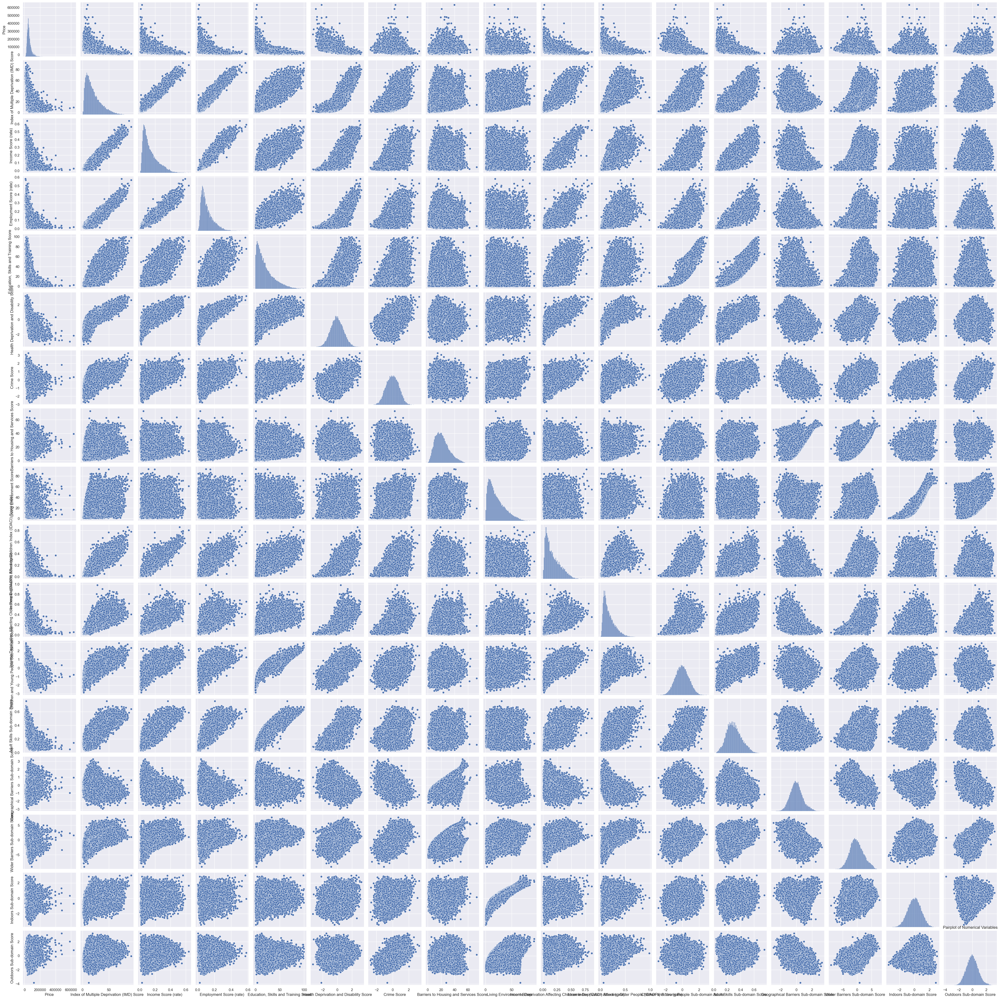

In [159]:
#visualizing relationship,correlation btw diff.variables
# Creating a pairplot
sns.pairplot(Clean_H_Price)
plt.title('Pairplot of Numerical Variables')
plt.show()

In [160]:
data= Clean_H_Price[['Index of Multiple Deprivation (IMD) Score', 'Income Score (rate)',
       'Employment Score (rate)', 'Education, Skills and Training Score',
       'Health Deprivation and Disability Score', 'Crime Score',
       'Barriers to Housing and Services Score', 'Living Environment Score',
       'Income Deprivation Affecting Children Index (IDACI) Score (rate)',
       'Income Deprivation Affecting Older People (IDAOPI) Score (rate)',
       'Children and Young People Sub-domain Score',
       'Adult Skills Sub-domain Score',
       'Geographical Barriers Sub-domain Score',
       'Wider Barriers Sub-domain Score', 'Indoors Sub-domain Score',
       'Outdoors Sub-domain Score','Price']]

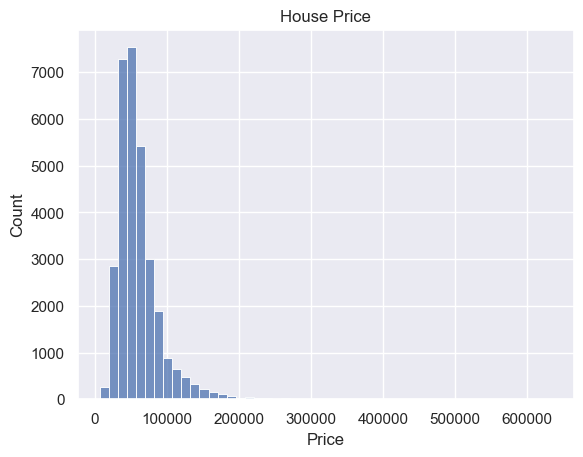

In [161]:
# Plot a histogram for the House price column
sns.set_style("darkgrid")
sns.histplot(data=data['Price'], bins=50)
plt.title('House Price');

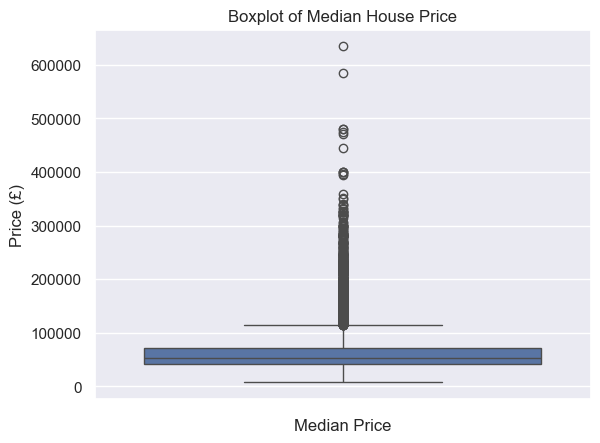

In [162]:
# Boxplot showing the distribution of the median house in the dataset
sns.boxplot(y='Price', data=Clean_H_Price)

# Add title and labels
plt.title('Boxplot of Median House Price')
plt.xlabel('Median Price')
plt.ylabel('Price (£)')

# Display the plot
plt.show()

In [163]:
# Removing Outliers
#lower quartile 25% 
#upper quartile 75%
Q1 = np.percentile(data['Price'], 25)
Q3 = np.percentile(data['Price'], 75)

# Calculating IQR
#75%-25%=50% of the data
IQR = Q3 - Q1 

print("Interquartile Range (IQR):", IQR)
print('Q3:',Q3)
print('Q1:',Q1)

Interquartile Range (IQR): 29500.0
Q3: 71000.0
Q1: 41500.0


In [31]:
#lower quartile  of the dataset
Q1-(1.5*IQR)

-2750.0

In [32]:
#upper quartile of the dataset
Q3+(1.5*IQR)

115250.0

In [33]:
#Using the upper quartile, price lesser than 115250
data = data[data['Price'] < 115250]

In [34]:
#lenght of data after removing outliers
len(data)

29552

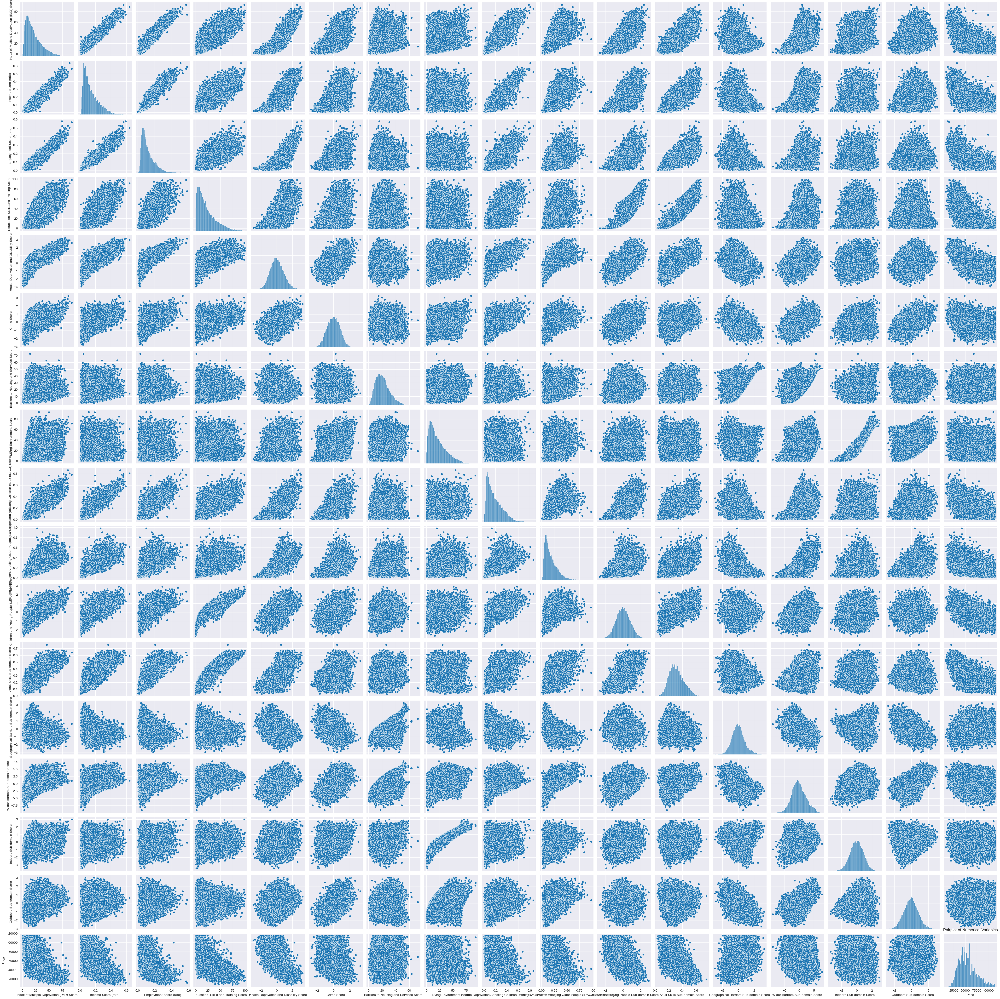

In [35]:
# Create a pairplot
sns.pairplot(data)
plt.title('Pairplot of Numerical Variables')
plt.show()

In [36]:
independent_var = data[['Index of Multiple Deprivation (IMD) Score', 'Income Score (rate)',
       'Employment Score (rate)', 'Education, Skills and Training Score',
       'Health Deprivation and Disability Score', 'Crime Score',
       'Barriers to Housing and Services Score', 'Living Environment Score',
       'Income Deprivation Affecting Children Index (IDACI) Score (rate)',
       'Income Deprivation Affecting Older People (IDAOPI) Score (rate)',
       'Children and Young People Sub-domain Score',
       'Adult Skills Sub-domain Score',
       'Geographical Barriers Sub-domain Score',
       'Wider Barriers Sub-domain Score', 'Indoors Sub-domain Score',
       'Outdoors Sub-domain Score']]

In [37]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 29552 entries, 0 to 32840
Data columns (total 17 columns):
 #   Column                                                            Non-Null Count  Dtype  
---  ------                                                            --------------  -----  
 0   Index of Multiple Deprivation (IMD) Score                         29552 non-null  float64
 1   Income Score (rate)                                               29552 non-null  float64
 2   Employment Score (rate)                                           29552 non-null  float64
 3   Education, Skills and Training Score                              29552 non-null  float64
 4   Health Deprivation and Disability Score                           29552 non-null  float64
 5   Crime Score                                                       29552 non-null  float64
 6   Barriers to Housing and Services Score                            29552 non-null  float64
 7   Living Environment Score            

In [38]:
independent_var.info()

<class 'pandas.core.frame.DataFrame'>
Index: 29552 entries, 0 to 32840
Data columns (total 16 columns):
 #   Column                                                            Non-Null Count  Dtype  
---  ------                                                            --------------  -----  
 0   Index of Multiple Deprivation (IMD) Score                         29552 non-null  float64
 1   Income Score (rate)                                               29552 non-null  float64
 2   Employment Score (rate)                                           29552 non-null  float64
 3   Education, Skills and Training Score                              29552 non-null  float64
 4   Health Deprivation and Disability Score                           29552 non-null  float64
 5   Crime Score                                                       29552 non-null  float64
 6   Barriers to Housing and Services Score                            29552 non-null  float64
 7   Living Environment Score            

In [39]:
data.describe()

,Index of Multiple Deprivation (IMD) Score,Income Score (rate),Employment Score (rate),"Education, Skills and Training Score",Health Deprivation and Disability Score,Crime Score,Barriers to Housing and Services Score,Living Environment Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate),Children and Young People Sub-domain Score,Adult Skills Sub-domain Score,Geographical Barriers Sub-domain Score,Wider Barriers Sub-domain Score,Indoors Sub-domain Score,Outdoors Sub-domain Score,Price
count,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000
mean,21.427931,0.144069,0.119210,21.797472,0.031253,-0.003143,21.039132,21.597370,0.182904,0.182978,0.024082,0.311102,-0.012359,-0.078754,0.020419,-0.035167,55240.281521
std,14.801590,0.096596,0.072188,17.644963,0.824713,0.774911,10.354389,15.702558,0.127225,0.119350,0.762928,0.106222,0.773686,2.350834,0.856914,0.823129,19913.022981
min,0.477000,0.005000,0.004000,0.021000,-2.982000,-2.750000,0.439000,0.151000,0.006000,0.007000,-2.635000,0.032000,-2.925000,-9.060000,-3.429000,-2.725000,7500.000000
25%,10.040750,0.068000,0.065000,8.157500,-0.546000,-0.555000,13.241000,9.134750,0.079000,0.091000,-0.513000,0.234000,-0.529000,-1.711000,-0.558000,-0.601000,40500.000000
50%,17.622000,0.116000,0.099000,16.855000,0.000500,0.001000,19.670500,17.582500,0.150000,0.151000,0.010000,0.301000,-0.046000,-0.229000,0.027000,-0.038500,52000.000000
75%,29.395750,0.198000,0.156000,30.942250,0.587250,0.551000,27.231500,30.773500,0.263000,0.246000,0.544000,0.380000,0.452000,1.459000,0.607000,0.510000,67000.000000
max,92.601000,0.639000,0.580000,99.500000,3.290000,3.277000,72.586000,93.352000,0.860000,0.980000,2.906000,0.754000,3.247000,7.721000,2.997000,3.039000,115010.000000


In [40]:
data.head()

,Index of Multiple Deprivation (IMD) Score,Income Score (rate),Employment Score (rate),"Education, Skills and Training Score",Health Deprivation and Disability Score,Crime Score,Barriers to Housing and Services Score,Living Environment Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate),Children and Young People Sub-domain Score,Adult Skills Sub-domain Score,Geographical Barriers Sub-domain Score,Wider Barriers Sub-domain Score,Indoors Sub-domain Score,Outdoors Sub-domain Score,Price
0,37.903,0.276,0.240,43.538,1.257,0.284,8.187,6.875,0.338,0.321,0.683,0.471,-0.532,-1.056,-0.565,-0.541,34750.0
1,61.643,0.399,0.368,50.673,1.676,1.224,5.406,23.238,0.595,0.239,1.028,0.474,-1.296,-1.057,0.533,-0.235,25000.0
2,44.727,0.304,0.291,39.238,1.235,0.752,7.637,18.399,0.386,0.255,0.903,0.398,-0.542,-1.231,0.202,-0.041,27000.0
3,44.652,0.330,0.289,44.151,1.380,0.112,9.769,8.249,0.431,0.283,0.523,0.495,-0.787,-0.166,-2.230,0.335,44500.0
4,57.619,0.421,0.328,65.815,1.392,0.661,9.012,3.476,0.485,0.429,0.955,0.579,-1.225,-0.024,-1.565,-0.408,22000.0


In [41]:

# Calculate correlations
correlations = {}

dependent_variable = 'Price'

for column in data.columns:
    if column != dependent_variable:
        corr_coefficient, _ = pearsonr(data[dependent_variable], data[column])
        correlations[column] = corr_coefficient

# Create a correlation table
correlation_table = pd.DataFrame(list(correlations.items()), columns=['Independent Variable', 'Correlation'])

# Display the correlation table
print(correlation_table)

                                 Independent Variable  Correlation
0           Index of Multiple Deprivation (IMD) Score    -0.599370
1                                 Income Score (rate)    -0.586559
2                             Employment Score (rate)    -0.616075
3                Education, Skills and Training Score    -0.622155
4             Health Deprivation and Disability Score    -0.685664
5                                         Crime Score    -0.367427
6              Barriers to Housing and Services Score     0.153229
7                            Living Environment Score    -0.215338
8   Income Deprivation Affecting Children Index (I...    -0.538737
9   Income Deprivation Affecting Older People (IDA...    -0.507913
10         Children and Young People Sub-domain Score    -0.597510
11                      Adult Skills Sub-domain Score    -0.643344
12             Geographical Barriers Sub-domain Score     0.314208
13                    Wider Barriers Sub-domain Score    -0.21

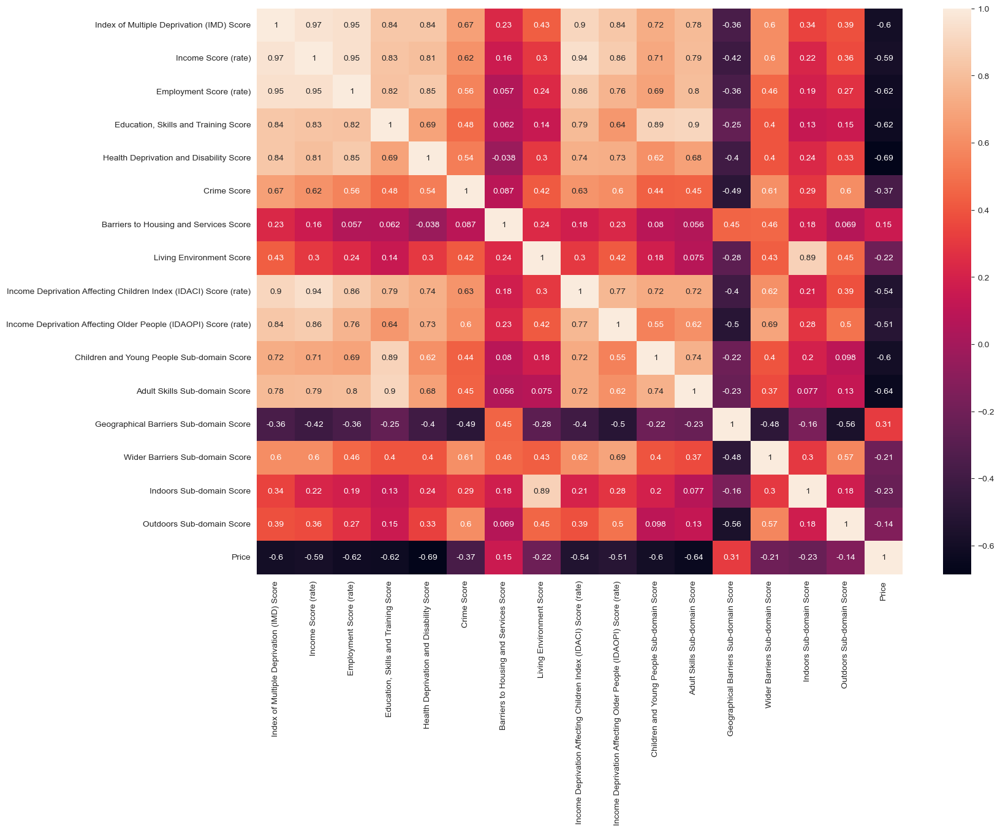

In [42]:
# plotting of heatmap to check the dataset correlation

fig, ax = plt.subplots(figsize=(17,12))
sns.heatmap(data.corr(), annot=True);

In [43]:
# Separate dependent variable and independent variables
X = data.drop('Price', axis=1)
y = data['Price']

In [44]:
# Standardize the independent variables
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [45]:
X_scaled

array([[ 1.11307953,  1.36582307,  1.67330589, ..., -0.41570874,
        -0.68318245, -0.61453462],
       [ 2.71698836,  2.63919037,  3.44648761, ..., -0.41613413,
         0.59818131, -0.2427761 ],
       [ 1.57411887,  1.6556953 ,  2.37980798, ..., -0.49015166,
         0.21190498, -0.00708605],
       ...,
       [ 2.15109365,  2.69095327,  1.71486484, ...,  2.57987419,
         1.01830057,  2.31093771],
       [ 1.84287832,  1.74886852,  2.04733641, ...,  2.1617177 ,
         1.08948745,  3.41406432],
       [ 2.29635077,  2.525312  ,  1.90880659, ...,  2.69302742,
         0.92494074,  2.36074849]])

In [46]:
# Perform PCA
pca = PCA()
principal_components = pca.fit_transform(X_scaled)

In [47]:
# Create a DataFrame to display the results
pca_results = pd.DataFrame(
    data=principal_components,
    columns=[f'PrincipalComponent{i+1}' for i in range(X.shape[1])]
)

In [48]:
# Display the results
print("Principal Components:")
print(pca_results)

Principal Components:
       PrincipalComponent1  PrincipalComponent2  PrincipalComponent3  \
0                 3.162782            -2.645189            -1.178889   
1                 6.268055            -2.033245            -1.462528   
2                 3.833878            -1.628837            -1.095474   
3                 3.950036            -3.160768            -1.943278   
4                 6.094370            -3.918872            -1.747200   
...                    ...                  ...                  ...   
29547             5.733673             3.211620             0.508893   
29548             4.446509             3.044883             0.137224   
29549             6.040059             2.985755             0.653576   
29550             4.813886             3.941380            -0.062570   
29551             6.210661             3.170611             0.533102   

       PrincipalComponent4  PrincipalComponent5  PrincipalComponent6  \
0                 0.510144             0.

In [49]:
# Explained variance ratio
explained_variance_ratio = pca.explained_variance_ratio_

# Display explained variance ratio
print("\nExplained Variance Ratio:")
for i, ratio in enumerate(explained_variance_ratio, 1):
    print(f"Principal Component {i}: {ratio:.4f}")


Explained Variance Ratio:
Principal Component 1: 0.5483
Principal Component 2: 0.1413
Principal Component 3: 0.0998
Principal Component 4: 0.0720
Principal Component 5: 0.0336
Principal Component 6: 0.0286
Principal Component 7: 0.0202
Principal Component 8: 0.0150
Principal Component 9: 0.0137
Principal Component 10: 0.0103
Principal Component 11: 0.0060
Principal Component 12: 0.0045
Principal Component 13: 0.0029
Principal Component 14: 0.0028
Principal Component 15: 0.0008
Principal Component 16: 0.0003


In [92]:
#High values in a particular principal component indicate that the corresponding original features contribute significantly to the variability captured by that component.

### DATA TRANSFORMATION 

In [50]:
# Create a DataFrame for the variable with a correllation of 0.5 and above
df_filtered= data[['Index of Multiple Deprivation (IMD) Score', 'Income Score (rate)',
       'Employment Score (rate)', 'Education, Skills and Training Score',
       'Health Deprivation and Disability Score',
       'Income Deprivation Affecting Children Index (IDACI) Score (rate)',
       'Income Deprivation Affecting Older People (IDAOPI) Score (rate)',
       'Children and Young People Sub-domain Score',
       'Adult Skills Sub-domain Score',
       'Price']]

In [51]:
len(df_filtered)

29552

In [52]:
df_filtered=df_filtered.reset_index(drop=True)

In [53]:
independent_var = data[['Index of Multiple Deprivation (IMD) Score', 'Income Score (rate)',
       'Employment Score (rate)', 'Education, Skills and Training Score',
       'Health Deprivation and Disability Score',
       'Income Deprivation Affecting Children Index (IDACI) Score (rate)',
       'Income Deprivation Affecting Older People (IDAOPI) Score (rate)',
       'Children and Young People Sub-domain Score',
       'Adult Skills Sub-domain Score']]

In [54]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 29552 entries, 0 to 32840
Data columns (total 17 columns):
 #   Column                                                            Non-Null Count  Dtype  
---  ------                                                            --------------  -----  
 0   Index of Multiple Deprivation (IMD) Score                         29552 non-null  float64
 1   Income Score (rate)                                               29552 non-null  float64
 2   Employment Score (rate)                                           29552 non-null  float64
 3   Education, Skills and Training Score                              29552 non-null  float64
 4   Health Deprivation and Disability Score                           29552 non-null  float64
 5   Crime Score                                                       29552 non-null  float64
 6   Barriers to Housing and Services Score                            29552 non-null  float64
 7   Living Environment Score            

In [56]:
# Statistical summary
data.describe()

,Index of Multiple Deprivation (IMD) Score,Income Score (rate),Employment Score (rate),"Education, Skills and Training Score",Health Deprivation and Disability Score,Crime Score,Barriers to Housing and Services Score,Living Environment Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate),Children and Young People Sub-domain Score,Adult Skills Sub-domain Score,Geographical Barriers Sub-domain Score,Wider Barriers Sub-domain Score,Indoors Sub-domain Score,Outdoors Sub-domain Score,Price
count,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000
mean,21.427931,0.144069,0.119210,21.797472,0.031253,-0.003143,21.039132,21.597370,0.182904,0.182978,0.024082,0.311102,-0.012359,-0.078754,0.020419,-0.035167,55240.281521
std,14.801590,0.096596,0.072188,17.644963,0.824713,0.774911,10.354389,15.702558,0.127225,0.119350,0.762928,0.106222,0.773686,2.350834,0.856914,0.823129,19913.022981
min,0.477000,0.005000,0.004000,0.021000,-2.982000,-2.750000,0.439000,0.151000,0.006000,0.007000,-2.635000,0.032000,-2.925000,-9.060000,-3.429000,-2.725000,7500.000000
25%,10.040750,0.068000,0.065000,8.157500,-0.546000,-0.555000,13.241000,9.134750,0.079000,0.091000,-0.513000,0.234000,-0.529000,-1.711000,-0.558000,-0.601000,40500.000000
50%,17.622000,0.116000,0.099000,16.855000,0.000500,0.001000,19.670500,17.582500,0.150000,0.151000,0.010000,0.301000,-0.046000,-0.229000,0.027000,-0.038500,52000.000000
75%,29.395750,0.198000,0.156000,30.942250,0.587250,0.551000,27.231500,30.773500,0.263000,0.246000,0.544000,0.380000,0.452000,1.459000,0.607000,0.510000,67000.000000
max,92.601000,0.639000,0.580000,99.500000,3.290000,3.277000,72.586000,93.352000,0.860000,0.980000,2.906000,0.754000,3.247000,7.721000,2.997000,3.039000,115010.000000


In [57]:
df_filtered.head()

,Index of Multiple Deprivation (IMD) Score,Income Score (rate),Employment Score (rate),"Education, Skills and Training Score",Health Deprivation and Disability Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate),Children and Young People Sub-domain Score,Adult Skills Sub-domain Score,Price
0,37.903,0.276,0.240,43.538,1.257,0.338,0.321,0.683,0.471,34750.0
1,61.643,0.399,0.368,50.673,1.676,0.595,0.239,1.028,0.474,25000.0
2,44.727,0.304,0.291,39.238,1.235,0.386,0.255,0.903,0.398,27000.0
3,44.652,0.330,0.289,44.151,1.380,0.431,0.283,0.523,0.495,44500.0
4,57.619,0.421,0.328,65.815,1.392,0.485,0.429,0.955,0.579,22000.0


In [58]:
df_filtered.describe()

,Index of Multiple Deprivation (IMD) Score,Income Score (rate),Employment Score (rate),"Education, Skills and Training Score",Health Deprivation and Disability Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate),Children and Young People Sub-domain Score,Adult Skills Sub-domain Score,Price
count,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000,29552.000000
mean,21.427931,0.144069,0.119210,21.797472,0.031253,0.182904,0.182978,0.024082,0.311102,55240.281521
std,14.801590,0.096596,0.072188,17.644963,0.824713,0.127225,0.119350,0.762928,0.106222,19913.022981
min,0.477000,0.005000,0.004000,0.021000,-2.982000,0.006000,0.007000,-2.635000,0.032000,7500.000000
25%,10.040750,0.068000,0.065000,8.157500,-0.546000,0.079000,0.091000,-0.513000,0.234000,40500.000000
50%,17.622000,0.116000,0.099000,16.855000,0.000500,0.150000,0.151000,0.010000,0.301000,52000.000000
75%,29.395750,0.198000,0.156000,30.942250,0.587250,0.263000,0.246000,0.544000,0.380000,67000.000000
max,92.601000,0.639000,0.580000,99.500000,3.290000,0.860000,0.980000,2.906000,0.754000,115010.000000


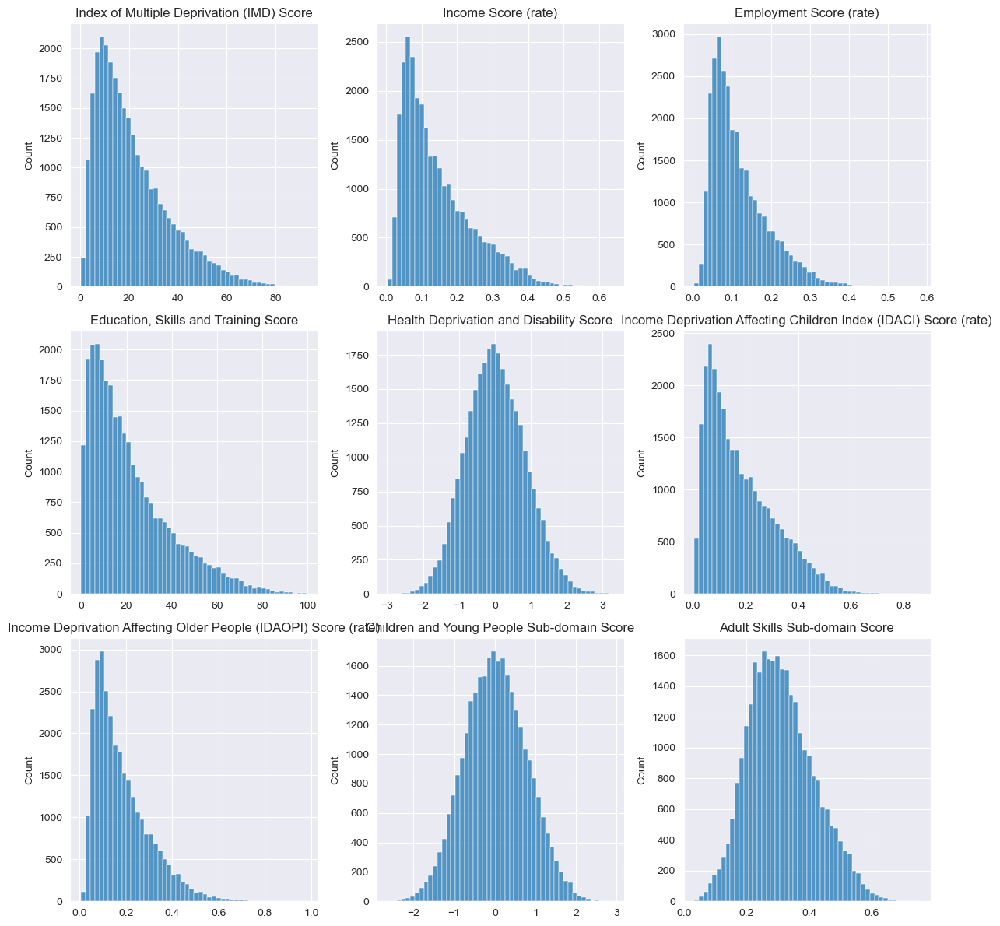

In [59]:
# Histogram  plot for the independent variable
# Set up for the figure and axes for subplots
fig, axs = plt.subplots(3, 3, figsize=(12, 12))

# Flatten the axs array to loop through all subplots
axs = axs.flatten()

for i, col in enumerate(independent_var.columns):
    sns.histplot(data=independent_var[col], bins=50, ax=axs[i], kde=False)
    axs[i].set_title(col)
    axs[i].set_xlabel(None)  # Removing x-axis label for better readability

# Adjusting layout and show plot
plt.tight_layout()
plt.show();

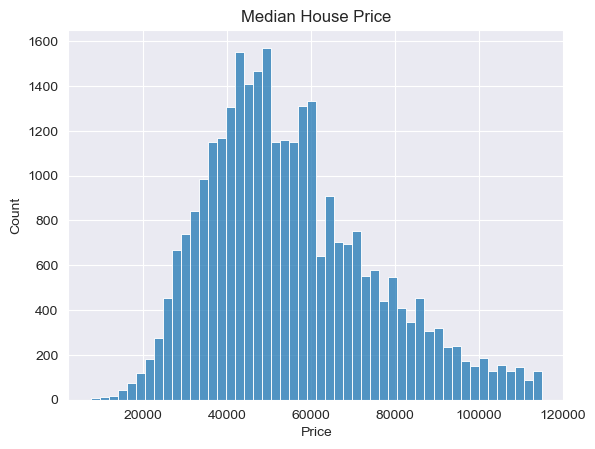

In [60]:
# Plot a histogram for the House price column
sns.set_style("darkgrid")
sns.histplot(data=df_filtered['Price'], bins=50)
plt.title('Median House Price');

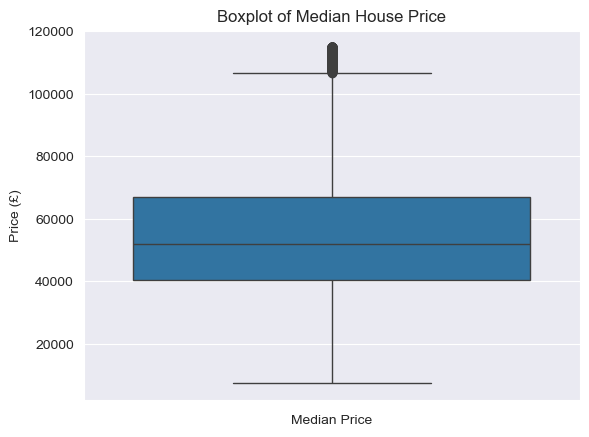

In [61]:
# Boxplot showing the distribution of the median house in the dataset
sns.boxplot(y='Price', data=df_filtered)

# Add title and labels
plt.title('Boxplot of Median House Price')
plt.xlabel('Median Price')
plt.ylabel('Price (£)')

# Display the plot
plt.show()

In [62]:
df_filtered

,Index of Multiple Deprivation (IMD) Score,Income Score (rate),Employment Score (rate),"Education, Skills and Training Score",Health Deprivation and Disability Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate),Children and Young People Sub-domain Score,Adult Skills Sub-domain Score,Price
0,37.903,0.276,0.240,43.538,1.257,0.338,0.321,0.683,0.471,34750.0
1,61.643,0.399,0.368,50.673,1.676,0.595,0.239,1.028,0.474,25000.0
2,44.727,0.304,0.291,39.238,1.235,0.386,0.255,0.903,0.398,27000.0
3,44.652,0.330,0.289,44.151,1.380,0.431,0.283,0.523,0.495,44500.0
4,57.619,0.421,0.328,65.815,1.392,0.485,0.429,0.955,0.579,22000.0
...,...,...,...,...,...,...,...,...,...,...
29547,52.875,0.384,0.238,15.765,0.972,0.497,0.465,-0.344,0.334,53000.0
29548,41.147,0.299,0.184,19.701,0.536,0.333,0.482,-0.471,0.384,80000.0
29549,53.267,0.404,0.243,23.007,0.846,0.512,0.474,-0.280,0.402,73500.0
29550,48.705,0.313,0.267,8.777,1.349,0.439,0.381,-0.548,0.263,82000.0


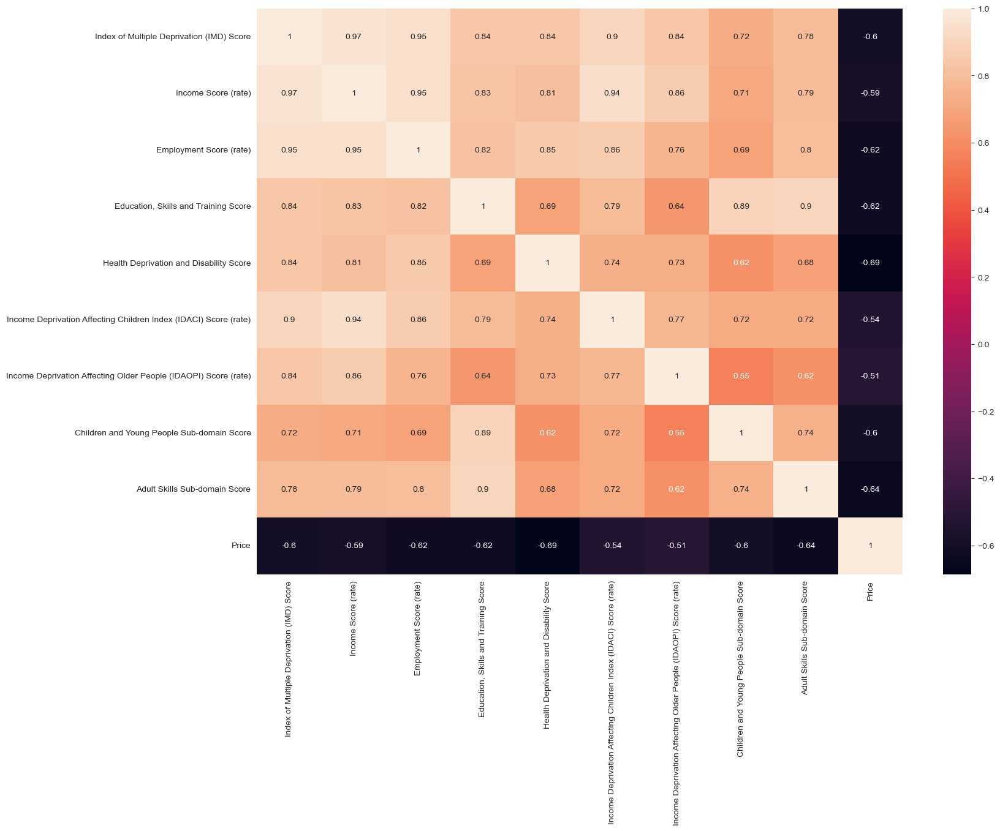

In [63]:
# plotting of heatmap to check the dataset correlation

fig, ax = plt.subplots(figsize=(17,12))
sns.heatmap(df_filtered.corr(), annot=True);

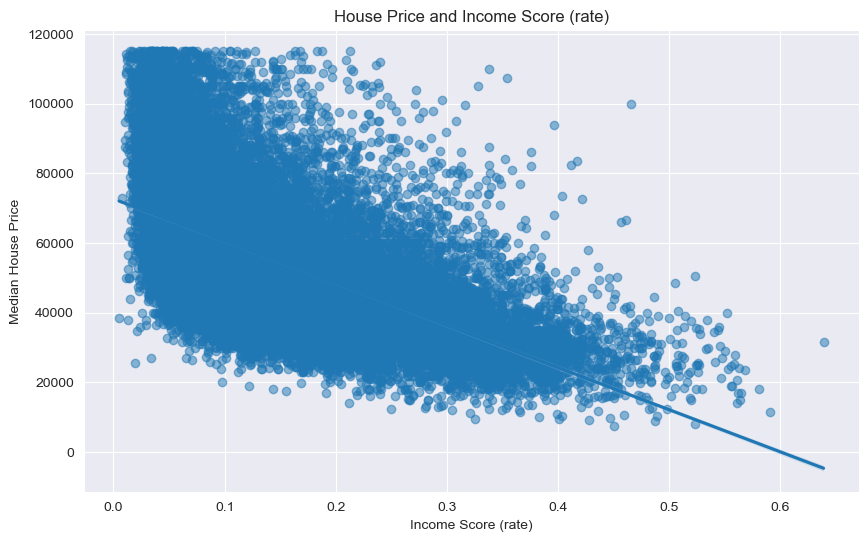

In [64]:
# Scatter plot with regression line
plt.figure(figsize=(10, 6))
sns.regplot(data=df_filtered, x='Income Score (rate)', y='Price', scatter_kws={'alpha':0.5})
plt.title('House Price and Income Score (rate)')
plt.xlabel('Income Score (rate)')
plt.ylabel('Median House Price')
plt.grid(True)
plt.show()

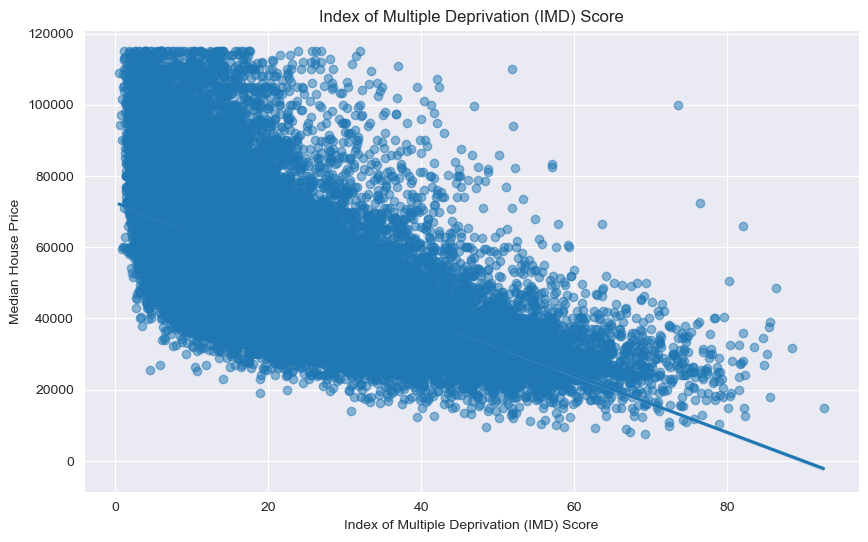

In [65]:
 # Scatter plot with regression line
plt.figure(figsize=(10, 6))
sns.regplot(data=df_filtered, x='Index of Multiple Deprivation (IMD) Score', y='Price', scatter_kws={'alpha':0.5})
plt.title('Index of Multiple Deprivation (IMD) Score')
plt.xlabel('Index of Multiple Deprivation (IMD) Score')
plt.ylabel('Median House Price')
plt.grid(True)
plt.show()

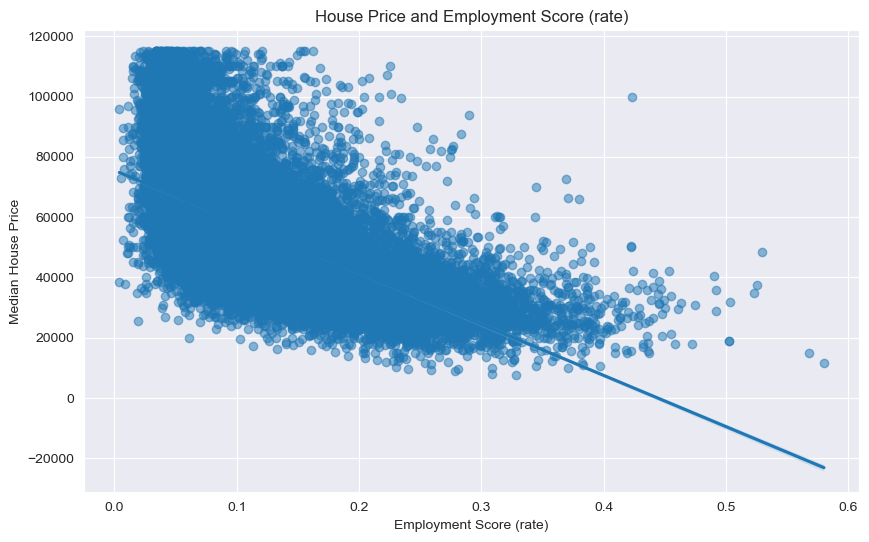

In [66]:
# Scatter plot with regression line
plt.figure(figsize=(10, 6))
sns.regplot(data=df_filtered, x='Employment Score (rate)', y='Price', scatter_kws={'alpha':0.5})
plt.title('House Price and Employment Score (rate)')
plt.xlabel('Employment Score (rate)')
plt.ylabel('Median House Price')
plt.grid(True)
plt.show()

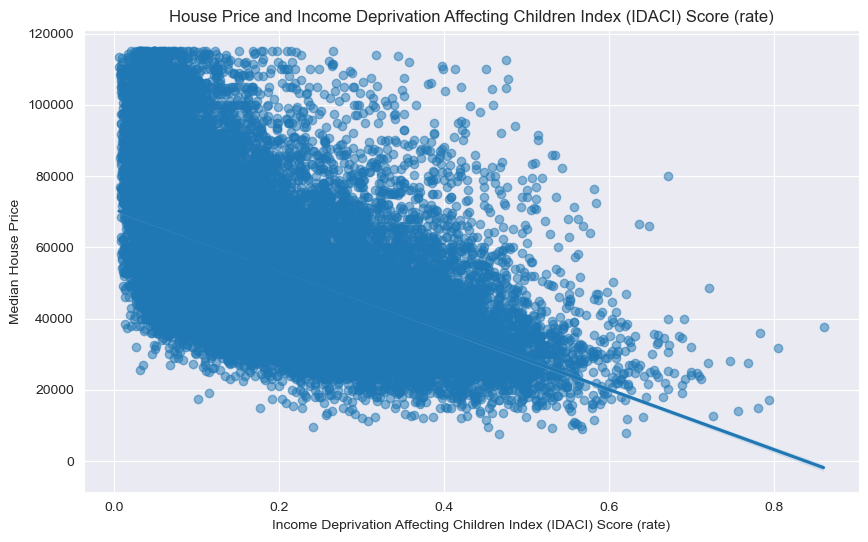

In [67]:
# Scatter plot with regression line
plt.figure(figsize=(10, 6))
sns.regplot(data=df_filtered, x='Income Deprivation Affecting Children Index (IDACI) Score (rate)', y='Price', scatter_kws={'alpha':0.5})
plt.title('House Price and Income Deprivation Affecting Children Index (IDACI) Score (rate)')
plt.xlabel('Income Deprivation Affecting Children Index (IDACI) Score (rate)')
plt.ylabel('Median House Price')
plt.grid(True)
plt.show()

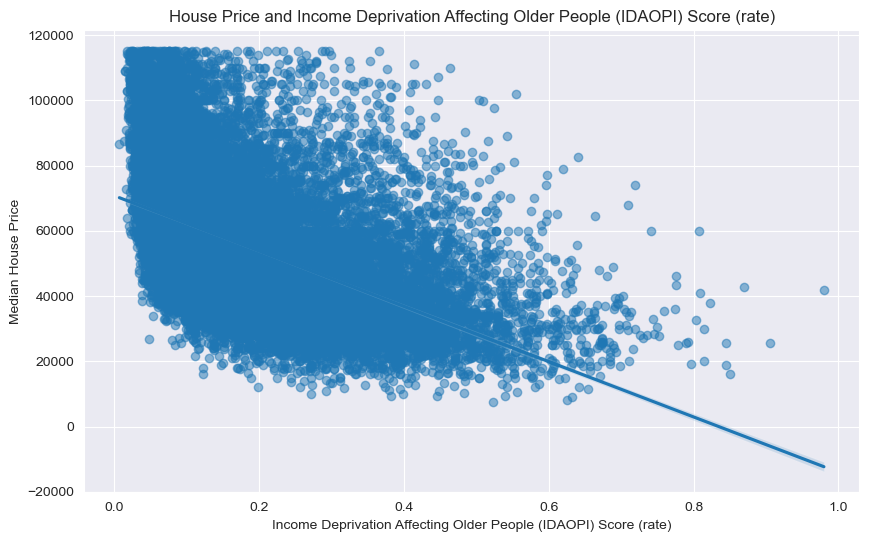

In [68]:
# Scatter plot with regression line
plt.figure(figsize=(10, 6))
sns.regplot(data=df_filtered, x='Income Deprivation Affecting Older People (IDAOPI) Score (rate)', y='Price', scatter_kws={'alpha':0.5})
plt.title('House Price and Income Deprivation Affecting Older People (IDAOPI) Score (rate)')
plt.xlabel('Income Deprivation Affecting Older People (IDAOPI) Score (rate)')
plt.ylabel('Median House Price')
plt.grid(True)
plt.show()

In [69]:
np.mean(df_filtered['Price'])

55240.28152070926

In [70]:
# Calculate correlation matrix
correlation_matrix = independent_var.corr()

In [71]:
print(correlation_matrix)

                                                    Index of Multiple Deprivation (IMD) Score  \
Index of Multiple Deprivation (IMD) Score                                            1.000000   
Income Score (rate)                                                                  0.965038   
Employment Score (rate)                                                              0.947851   
Education, Skills and Training Score                                                 0.837072   
Health Deprivation and Disability Score                                              0.840985   
Income Deprivation Affecting Children Index (ID...                                   0.902049   
Income Deprivation Affecting Older People (IDAO...                                   0.841871   
Children and Young People Sub-domain Score                                           0.724650   
Adult Skills Sub-domain Score                                                        0.783681   

                             

In [72]:
VIF_data = df_filtered.drop('Price', axis=1)

In [73]:
# Calculate VIF
vif = pd.DataFrame()
vif['Variable'] = VIF_data.columns
vif['VIF'] = [variance_inflation_factor(VIF_data.values, i) for i in range(VIF_data.shape[1])]

In [74]:
vif

,Variable,VIF
0,Index of Multiple Deprivation (IMD) Score,67.251147
1,Income Score (rate),146.777569
2,Employment Score (rate),75.162580
3,"Education, Skills and Training Score",38.157881
4,Health Deprivation and Disability Score,3.123913
5,Income Deprivation Affecting Children Index (I...,34.412994
6,Income Deprivation Affecting Older People (IDA...,18.327203
7,Children and Young People Sub-domain Score,5.733991
8,Adult Skills Sub-domain Score,35.124001


In [75]:
# Selected columns for the dependent Variable

col= ['Index of Multiple Deprivation (IMD) Score', 'Income Score (rate)',
       'Employment Score (rate)', 'Education, Skills and Training Score',
       'Health Deprivation and Disability Score',
       'Income Deprivation Affecting Children Index (IDACI) Score (rate)',
       'Income Deprivation Affecting Older People (IDAOPI) Score (rate)',
       'Children and Young People Sub-domain Score',
       'Adult Skills Sub-domain Score']

In [76]:
# Seperating the original data into depenedent and indepedent variable
X = df_filtered.drop('Price', axis=1)
y = df_filtered['Price']

In [77]:
# Initialize the StandardScaler
scaler = StandardScaler()

# Standardize the selected columns while retaining the column names
df_standardized = pd.DataFrame(scaler.fit_transform(df_filtered[col]), columns=col)

# Concatenate the standardized columns with the remaining columns in the original DataFrame
df1= pd.concat([df_filtered.drop(columns=col), df_standardized], axis=1)

# Print the standardized DataFrame with column names
df1.head()

,Price,Index of Multiple Deprivation (IMD) Score,Income Score (rate),Employment Score (rate),"Education, Skills and Training Score",Health Deprivation and Disability Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate),Children and Young People Sub-domain Score,Adult Skills Sub-domain Score
0,34750.0,1.113080,1.365823,1.673306,1.232130,1.486297,1.219096,1.156463,0.863684,1.505341
1,25000.0,2.716988,2.639190,3.446488,1.636502,1.994361,3.239181,0.469399,1.315897,1.533584
2,27000.0,1.574119,1.655695,2.379808,0.988431,1.459621,1.596388,0.603460,1.152052,0.818091
3,44500.0,1.569052,1.924862,2.352102,1.266872,1.635443,1.950099,0.838067,0.653962,1.731286
4,22000.0,2.445121,2.866947,2.892368,2.494665,1.649993,2.374553,2.061377,1.220211,2.522094


In [78]:
len(df_filtered)

29552

In [79]:
# Separating features (X) and target variable (y) for standardized variable
X_scaled = df1.drop('Price', axis=1)
y_scaled = df1['Price']

In [80]:
y_scaled

0        34750.0
1        25000.0
2        27000.0
3        44500.0
4        22000.0
          ...   
29547    53000.0
29548    80000.0
29549    73500.0
29550    82000.0
29551    62300.0
Name: Price, Length: 29552, dtype: float64

In [81]:
# Split the data into training and testing sets for the original dataset,80%,20%tst
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [82]:
# Split the data into training and testing sets for standardized dataset
X_train_s, X_test_s, y_train_s, y_test_s = train_test_split(X_scaled, y_scaled, test_size=0.2, random_state=42)

## REGRESSION MODEL 

In [83]:
X_1 = sm.add_constant(X_train_s)  # Add a constant for the intercept term

# Fit the regression model
model = sm.OLS(y_train_s, X_train_s).fit()

# Print out the summary
print(model.summary())

                                 OLS Regression Results                                
Dep. Variable:                  Price   R-squared (uncentered):                   0.063
Model:                            OLS   Adj. R-squared (uncentered):              0.062
Method:                 Least Squares   F-statistic:                              175.2
Date:                Thu, 25 Apr 2024   Prob (F-statistic):                   3.95e-323
Time:                        12:55:48   Log-Likelihood:                     -2.9234e+05
No. Observations:               23641   AIC:                                  5.847e+05
Df Residuals:                   23632   BIC:                                  5.848e+05
Df Model:                           9                                                  
Covariance Type:            nonrobust                                                  
                                                                       coef    std err          t      P>|t|      [0.025

In [84]:
# Ordinary Least Squares (OLS) Regression
ols_model = LinearRegression()
ols_model.fit(X_train_s, y_train_s)

LinearRegression()

In [85]:
from sklearn.metrics import r2_score, mean_squared_error
#Evaluting the OLSregression model
y_pred = ols_model.predict(X_test_s)
# Calculate R-squared (coefficient of determination)
r2_ols = r2_score(y_test_s, y_pred)
print("OLS Regression R-squared:", r2_ols)

# Calculate Root Mean Squared Error (RMSE)
rmse_ols = mean_squared_error(y_test_s, y_pred, squared=False)
print("OLS Regression RMSE:", rmse_ols)

OLS Regression R-squared: 0.5631459272769102
OLS Regression RMSE: 13336.383409464263


In [86]:
# Define the Ridge regression model

ridge_model = Ridge()

# Define the alpha values to be tested
alphas = [0.001, 0.01, 0.1, 1, 10, 100]  # Example alpha values, adjust
# Perform GridSearchCV with 5-fold cross-validation
param_grid = {'alpha': alphas}
grid_search = GridSearchCV(estimator=ridge_model, param_grid=param_grid, scoring='neg_root_mean_squared_error', cv=5)
grid_search.fit(X_train_s, y_train_s)

# Get the best alpha value and corresponding RMSE score
best_alpha = grid_search.best_params_['alpha']
best_rmse = -grid_search.best_score_

print(f"Best Alpha: {best_alpha}")
print(f"Best RMSE: {best_rmse}")

# Train the Ridge regression model with the best alpha value
final_model = Ridge(alpha=best_alpha)
final_model.fit(X_train_s, y_train_s)

# Evaluate the model on the test set
y_pred = final_model.predict(X_test_s)
test_rmse = mean_squared_error(y_test_s, y_pred, squared=False)
print(f"Test RMSE with Best Alpha: {test_rmse}")

Best Alpha: 10
Best RMSE: 13203.514922627384
Test RMSE with Best Alpha: 13336.896838612654


In [87]:
# Ridge Regression
ridge_model = Ridge(alpha=10)  # 10 was used for the regularization (Alpha) based on the result from the Gridsearch
ridge_model.fit(X_train_s, y_train_s)

# Displaying the model summary
print("Ridge Regression Model Summary:")
print(f"Intercept: {ridge_model.intercept_}")
print("Coefficients:")
coefficients_df = pd.DataFrame({
    'Variable': X_train_s.columns,
    'Coefficient': ridge_model.coef_
    
})
print(coefficients_df)

# Evaluating the model
y_pred = ridge_model.predict(X_test_s)
rmse = mean_squared_error(y_test_s, y_pred, squared=False)
print(f"Root Mean Squared Error (RMSE): {rmse}")

# Calculate the R-squared value
r_squared = r2_score(y_test_s, y_pred)

print(f"R-squared value: {r_squared}")

Ridge Regression Model Summary:
Intercept: 55231.82791174017
Coefficients:
                                            Variable   Coefficient
0          Index of Multiple Deprivation (IMD) Score   4339.580281
1                                Income Score (rate)   -518.140715
2                            Employment Score (rate)    406.393054
3               Education, Skills and Training Score   2902.931131
4            Health Deprivation and Disability Score -11213.748901
5  Income Deprivation Affecting Children Index (I...   1768.371515
6  Income Deprivation Affecting Older People (IDA...   -786.734330
7         Children and Young People Sub-domain Score  -5802.290001
8                      Adult Skills Sub-domain Score  -7533.454992
Root Mean Squared Error (RMSE): 13336.896838612654
R-squared value: 0.5631122902817649


In [88]:
# the Ridge regression model
ridge_model = Ridge(alpha=10)  #   alpha parameter adjustment

# Performing cross-validation with 10 folds
cv_scores = cross_val_score(ridge_model, X_train_s, y_train_s, cv=10, scoring='r2')

# Print the cross-validation scores
print("Cross-validation scores:", cv_scores)
print(f"Mean R-squared value: {np.mean(cv_scores)}")

Cross-validation scores: [0.57344048 0.52906089 0.55293952 0.57096685 0.56027082 0.5465967
 0.5587614  0.56388508 0.57459397 0.54022557]
Mean R-squared value: 0.5570741288472456


In [89]:
# Created a Ridge regression model
ridge_model = Ridge(alpha=10) 

# Define custom scoring function for RMSE
def rmse_score(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

# Used make_scorer to create a scorer object for RMSE
rmse_scorer = make_scorer(rmse_score, greater_is_better=False)

# Performed cross-validation with RMSE scoring
rmse_scores = cross_val_score(ridge_model, X_train_s, y_train_s, cv=10, scoring=rmse_scorer)

# Converted negative RMSE scores to positive
rmse_scores = -rmse_scores

# Calculated average RMSE
average_rmse = np.mean(rmse_scores)

# Print the RMSE scores and average RMSE
print("RMSE Scores:", rmse_scores)
print("Average RMSE:", average_rmse)

RMSE Scores: [12533.97717471 13236.6290345  13207.79253559 13156.04834419
 13238.74782883 13483.69788461 13471.82174199 13099.17422071
 13266.42403621 13312.74231287]
Average RMSE: 13200.70551141974


In [90]:
np.mean(y)

55240.28152070926

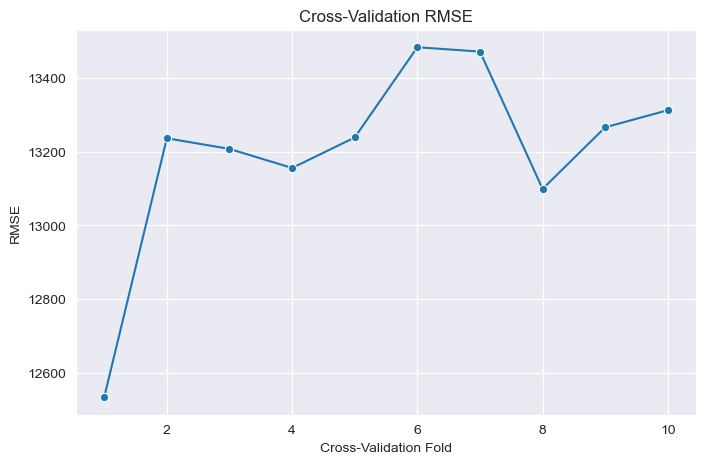

In [91]:
# Creating a DataFrame with fold/iteration numbers and RMSE values
df_cv_rmse = pd.DataFrame({'Fold': range(1, len(rmse_scores) + 1), 'RMSE': rmse_scores})

# Plotting using Seaborn
plt.figure(figsize=(8, 5))
sns.lineplot(data=df_cv_rmse, x='Fold', y='RMSE', marker='o')
plt.xlabel('Cross-Validation Fold')
plt.ylabel('RMSE')
plt.title('Cross-Validation RMSE')
plt.grid(True)
plt.show()

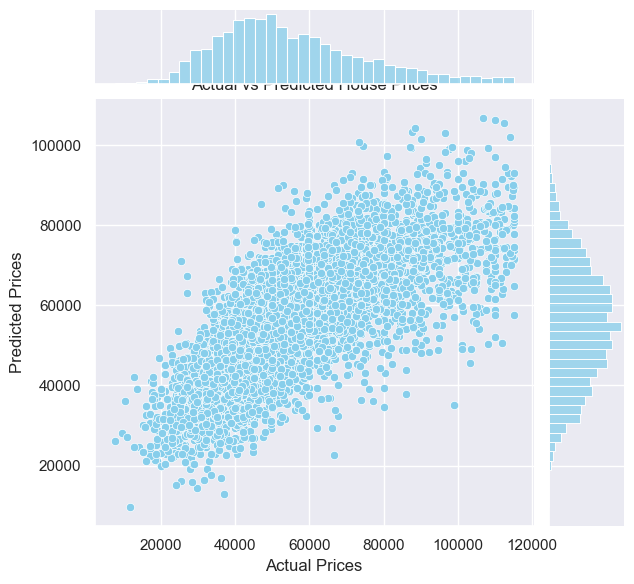

In [92]:
# Create a jointplot using seaborn in understanding the relationship,distribution ,showing conformation
sns.set(style="darkgrid")
sns.jointplot(x=y_test_s, y=y_pred, kind="scatter", color="skyblue")


# Add labels and title
plt.xlabel('Actual Prices')
plt.ylabel('Predicted Prices')
plt.title('Actual vs Predicted House Prices')

# Show the plot
plt.show()

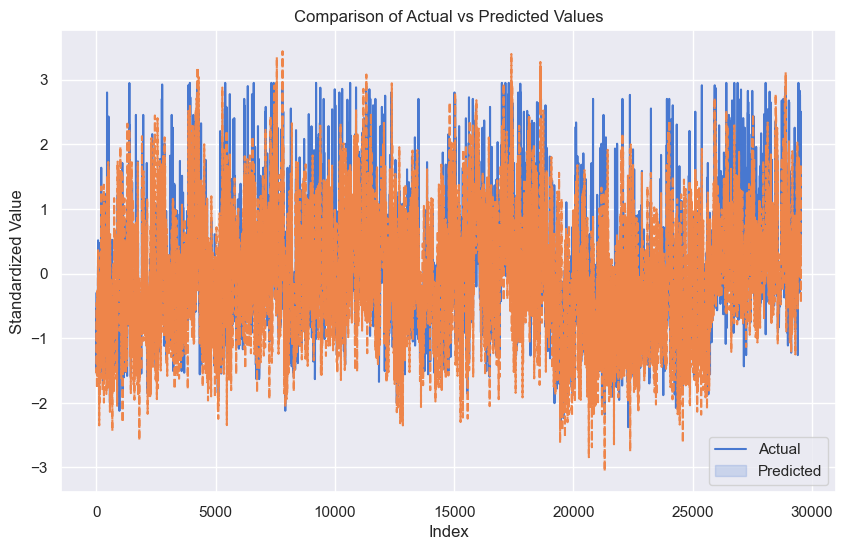

In [93]:
# Standardize actual and predicted values
actual_std = (y_test_s - np.mean(y_test_s)) / np.std(y_test_s)
predicted_std = (y_pred - np.mean(y_pred)) / np.std(y_pred)

# Create a DataFrame for plotting
data_pred = {
    'Index': np.arange(len(y_test_s)),
    'Actual': actual_std,
    'Predicted': predicted_std
}
df = pd.DataFrame(data_pred)

# Plot using Seaborn with darkgrid style
plt.figure(figsize=(10, 6))
sns.set(style='darkgrid')  # Set Seaborn style to darkgrid
sns.lineplot(data=df[['Actual', 'Predicted']], palette='muted')
plt.xlabel('Index')
plt.ylabel('Standardized Value')
plt.title('Comparison of Actual vs Predicted Values')
plt.legend(['Actual', 'Predicted'])
plt.show()

In [94]:
# Instantiating the Ridge regression model
ridge_model = Ridge(alpha=10)  #can choose an appropriate alpha value

# Fit the model on the training data
ridge_model.fit(X_train_s, y_train_s)#Added

# Predict on the test set and calculate RMSE for Ridge
y_pred_ridge = ridge_model.predict(X_test_s)
rmse_ridge = mean_squared_error(y_test_s, y_pred_ridge, squared=False)
print("Ridge Regression RMSE:", rmse_ridge)

Ridge Regression RMSE: 13336.896838612654


### Other Models

In [95]:
# To fit the decision tree regressor model
model = DecisionTreeRegressor(random_state=42)
model.fit(X_train_s, y_train_s)

# Make predictions on the test set
y_pred = model.predict(X_test_s)

# Calculate RMSE and R-squared
rmse = np.sqrt(mean_squared_error(y_test_s, y_pred))
r2 = r2_score(y_test_s, y_pred)

print(f'Root Mean Squared Error (RMSE): {rmse}')
print(f'R-squared Value: {r2}')

Root Mean Squared Error (RMSE): 18361.89401466833
R-squared Value: 0.17187633336908592


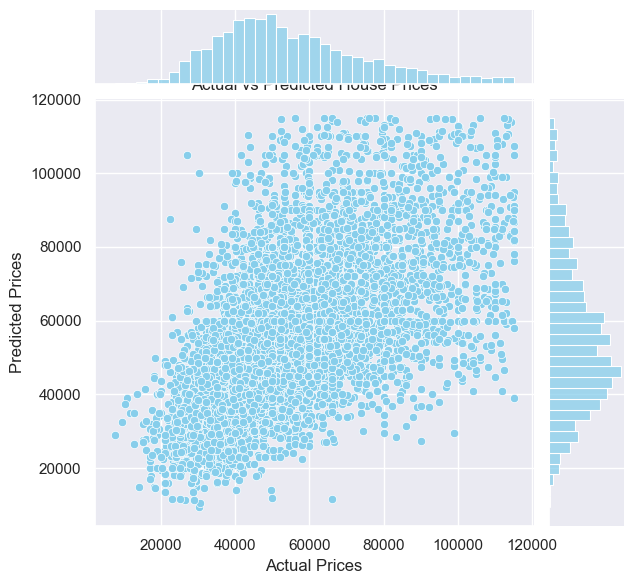

In [96]:
# Create a jointplot
sns.set(style="darkgrid")
sns.jointplot(x=y_test_s, y=y_pred, kind="scatter", color="skyblue")


# Add labels and title
plt.xlabel('Actual Prices')
plt.ylabel('Predicted Prices')
plt.title('Actual vs Predicted House Prices')

# Show the plot
plt.show()

In [97]:
# To fit the Random Forest regressor model
model = RandomForestRegressor(n_estimators=100, random_state=42)  # can adjust the number of estimators
model.fit(X_train_s, y_train_s)

# Make predictions on the test set
y_pred = model.predict(X_test_s)

# Calculate RMSE and R-squared
rmse = np.sqrt(mean_squared_error(y_test_s, y_pred))
r2 = r2_score(y_test_s, y_pred)

print(f'Root Mean Squared Error (RMSE): {rmse}')
print(f'R-squared Value: {r2}')

Root Mean Squared Error (RMSE): 13113.645167925035
R-squared Value: 0.5776163485916623


Mean Squared Error is a measure of the average squared difference between the actual values (ground truth) and the predicted values by the model. It is calculated as the average of the squared residuals (the differences between actual and predicted values) for each data point in the test set.

R-squared, also known as the coefficient of determination, measures the proportion of the variance in the target variable that is explained by the model. It ranges from 0 to 1, where 0 indicates that the model does not explain any variance and 1 indicates that the model perfectly explains the variance in the target variable.

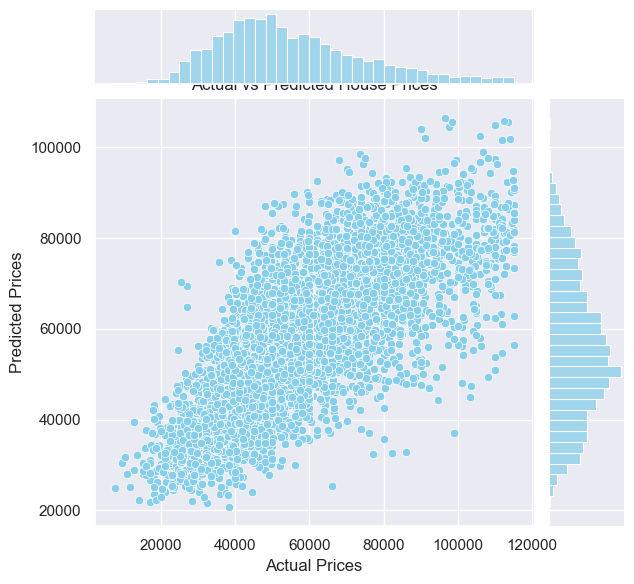

In [98]:
# Create a jointplot
sns.set(style="darkgrid")
sns.jointplot(x=y_test_s, y=y_pred, kind="scatter", color="skyblue")

# Add labels and title
plt.xlabel('Actual Prices')
plt.ylabel('Predicted Prices')
plt.title('Actual vs Predicted House Prices')

# Show the plot
plt.show()

In [99]:
# To Fit the Support Vector Machine (SVM) regressor model
model = SVR(kernel='rbf')
model.fit(X_train_s, y_train_s)

# Make predictions on the test set
y_pred = model.predict(X_test_s)

# Calculate RMSE and R-squared
rmse = np.sqrt(mean_squared_error(y_test_s, y_pred))
r2 = r2_score(y_test_s, y_pred)

print(f'Root Mean Squared Error (RMSE): {rmse}')
print(f'R-squared Value: {r2}')

Root Mean Squared Error (RMSE): 19117.11900802161
R-squared Value: 0.10235393540330129


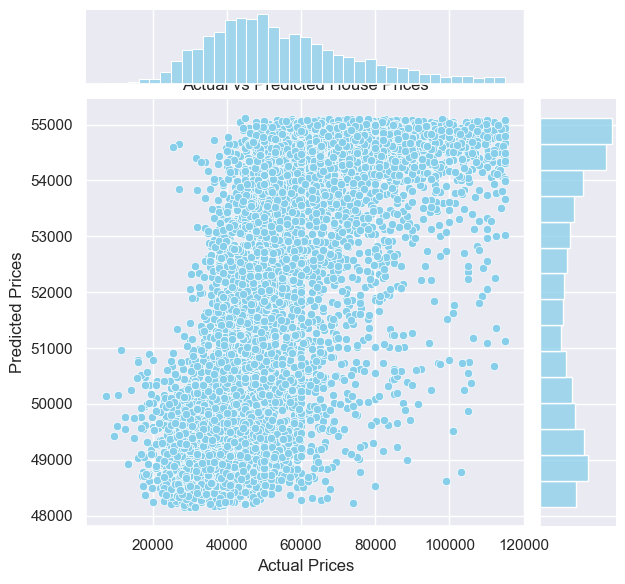

In [100]:
# Create a jointplot
sns.set(style="darkgrid")
sns.jointplot(x=y_test_s, y=y_pred, kind="scatter", color="skyblue")


# Add labels and title
plt.xlabel('Actual Prices')
plt.ylabel('Predicted Prices')
plt.title('Actual vs Predicted House Prices')

# Show the plot
plt.show()

In [101]:
#  To Fit the XGBoost regressor model
model = XGBRegressor()
model.fit(X_train_s, y_train_s)

# Make predictions on the test set
y_pred = model.predict(X_test_s)

# Calculate RMSE and R-squared
rmse = np.sqrt(mean_squared_error(y_test_s, y_pred))
r2 = r2_score(y_test_s, y_pred)

print(f'Root Mean Squared Error (RMSE): {rmse}')
print(f'R-squared Value: {r2}')

Root Mean Squared Error (RMSE): 13255.712475261676
R-squared Value: 0.5684149478961327


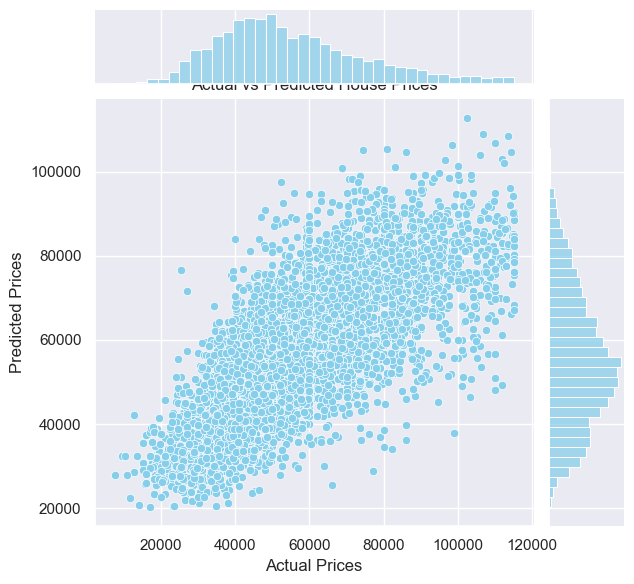

In [102]:
# Created a jointplot,showing the relationship on how they conform
sns.set(style="darkgrid")
sns.jointplot(x=y_test_s, y=y_pred, kind="scatter", color="skyblue")


# Add labels and title
plt.xlabel('Actual Prices')
plt.ylabel('Predicted Prices')
plt.title('Actual vs Predicted House Prices')

# Show the plot
plt.show()

In [103]:

# To Build the neural network model
model = Sequential()
model.add(Dense(128, activation='relu', input_shape=(X_train_s.shape[1],)))
model.add(Dense(64, activation='relu'))
model.add(Dense(1, activation='linear'))

# Compile the model
model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error')

#To Fit the model to the training data
model.fit(X_train_s, y_train_s, epochs=100, batch_size=32, verbose=1)

# Make predictions on the test set
y_pred = model.predict(X_test_s)

# Calculated RMSE and R-squared
rmse = np.sqrt(mean_squared_error(y_test_s, y_pred))
r2 = r2_score(y_test_s, y_pred)

print(f'Root Mean Squared Error (RMSE): {rmse}')
print(f'R-squared Value: {r2}')

Epoch 1/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - loss: 3188847616.0000
Epoch 2/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 866897344.0000
Epoch 3/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 535512896.0000
Epoch 4/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 321610560.0000
Epoch 5/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 250968624.0000
Epoch 6/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 214042464.0000
Epoch 7/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 203740960.0000
Epoch 8/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 189664032.0000
Epoch 9/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 187702944.0000
Epoch 10/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 179103056.0000
Epoch 11/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 175217408.0000
Epoch 12/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 177820144.0000
Epoch 13/100
739/739 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 172468864.0000
Epoch 1

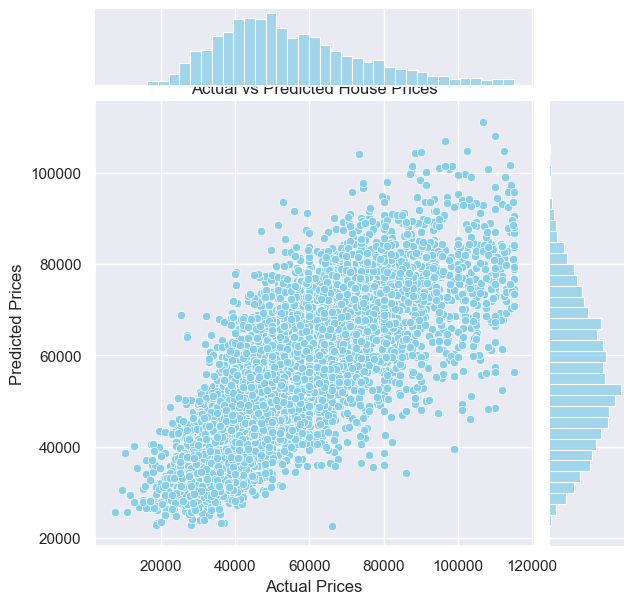

In [104]:
import seaborn as sns
import matplotlib.pyplot as plt

# y_test_s and y_pred are arrays that need reshaping or extraction
#E.g reshaping or extraction (can be adjust as needed)
y_test_s_1d = y_test_s.ravel()  # Convert to 1D array
y_pred_1d = y_pred.ravel()  # Convert to 1D array

# Created a jointplot
sns.set(style="darkgrid")
sns.jointplot(x=y_test_s_1d, y=y_pred_1d, kind="scatter", color="skyblue")


#To Add labels and title
plt.xlabel('Actual Prices')
plt.ylabel('Predicted Prices')
plt.title('Actual vs Predicted House Prices')

# Show the plot
plt.show()

In [105]:
#PCA ANALYSIS


# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Performed PCA to reduce dimensionality
pca = PCA(n_components=3)  # Choose the number of components
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

# To Fit OLS regression on the principal components
X_train_pca = sm.add_constant(X_train_pca)  # Add constant term for OLS
model = sm.OLS(y_train, X_train_pca)
results = model.fit()

# Predict on test set
X_test_pca = sm.add_constant(X_test_pca)  # Add constant term for predictions
y_pred = results.predict(X_test_pca)

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r_squared = r2_score(y_test, y_pred)


# To Print out all the result information
print("PCR-OLS Results:")
print(results.summary())
print(f"\nRoot Mean Squared Error (RMSE): {rmse}")
print(f"R-squared score: {r_squared}")

PCR-OLS Results:
                            OLS Regression Results                            
Dep. Variable:                  Price   R-squared:                       0.506
Model:                            OLS   Adj. R-squared:                  0.506
Method:                 Least Squares   F-statistic:                     8082.
Date:                Thu, 25 Apr 2024   Prob (F-statistic):               0.00
Time:                        13:08:05   Log-Likelihood:            -2.5915e+05
No. Observations:               23641   AIC:                         5.183e+05
Df Residuals:                   23637   BIC:                         5.183e+05
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.519e+04     90.693   

In [106]:
# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Perform PCA to reduce dimensionality
pca = PCA(n_components=3)  # Choose the number of components
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

#To Fit Ridge regression on the principal components
ridge_model = Ridge(alpha=1.0)  # Alpha is the regularization strength
ridge_model.fit(X_train_pca, y_train)

# Predict on test set
y_pred = ridge_model.predict(X_test_pca)

# Calculate RMSE and R-squared
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r_squared = r2_score(y_test, y_pred)

# Print out all the result information
print("PCR-Ridge Regression Results:")
print(f"\nRoot Mean Squared Error (RMSE): {rmse}")
print(f"R-squared score: {r_squared}")

PCR-Ridge Regression Results:

Root Mean Squared Error (RMSE): 14204.508010347105
R-squared score: 0.5044212957845334


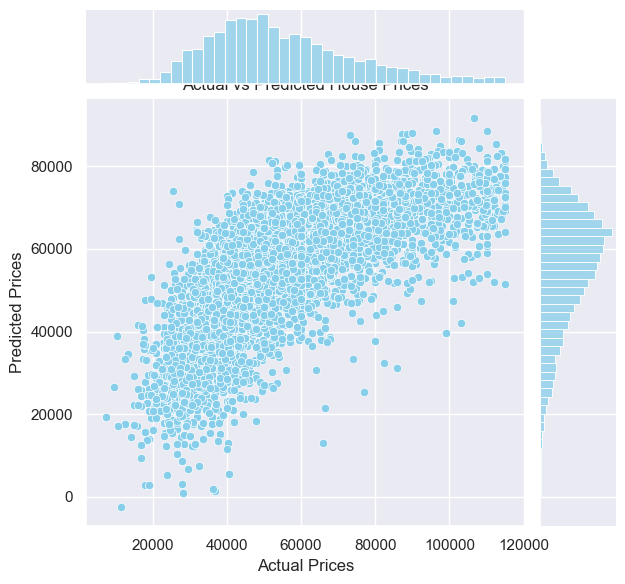

In [107]:
# Create a jointplot
sns.set(style="darkgrid")
sns.jointplot(x=y_test, y=y_pred, kind="scatter", color="skyblue")


# To Add labels and Title
plt.xlabel('Actual Prices')
plt.ylabel('Predicted Prices')
plt.title('Actual vs Predicted House Prices')

# Show the plot
plt.show()

## CLUSTERING ANALYSIS

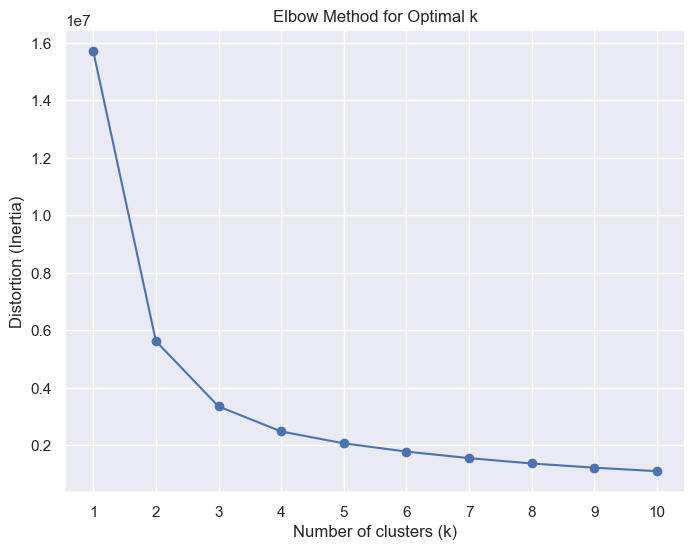

In [108]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs

#To Calculate distortion (inertia) for different values of k
distortions = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=0)
    kmeans.fit(X)
    distortions.append(kmeans.inertia_)

# Plotting the elbow curve
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), distortions, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Distortion (Inertia)')
plt.title('Elbow Method for Optimal k')
plt.xticks(range(1, 11))
plt.grid(True)
plt.show()


In [119]:
#Clustering Analysis

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Perform clustering
kmeans = KMeans(n_clusters=3, random_state=42)  # the number of clusters specified
clusters = kmeans.fit_predict(X_scaled)

#  cluster labels to the dataset add
df_filtered['cluster'] = clusters



In [120]:
df3 = df1.drop("Price", axis=1)

In [121]:
# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Perform clustering
kmeans = KMeans(n_clusters=3, random_state=42)  #  the number of clusters specified
clusters = kmeans.fit_predict(X_scaled)

# cluster labels to the dataset add
df3['cluster'] = clusters

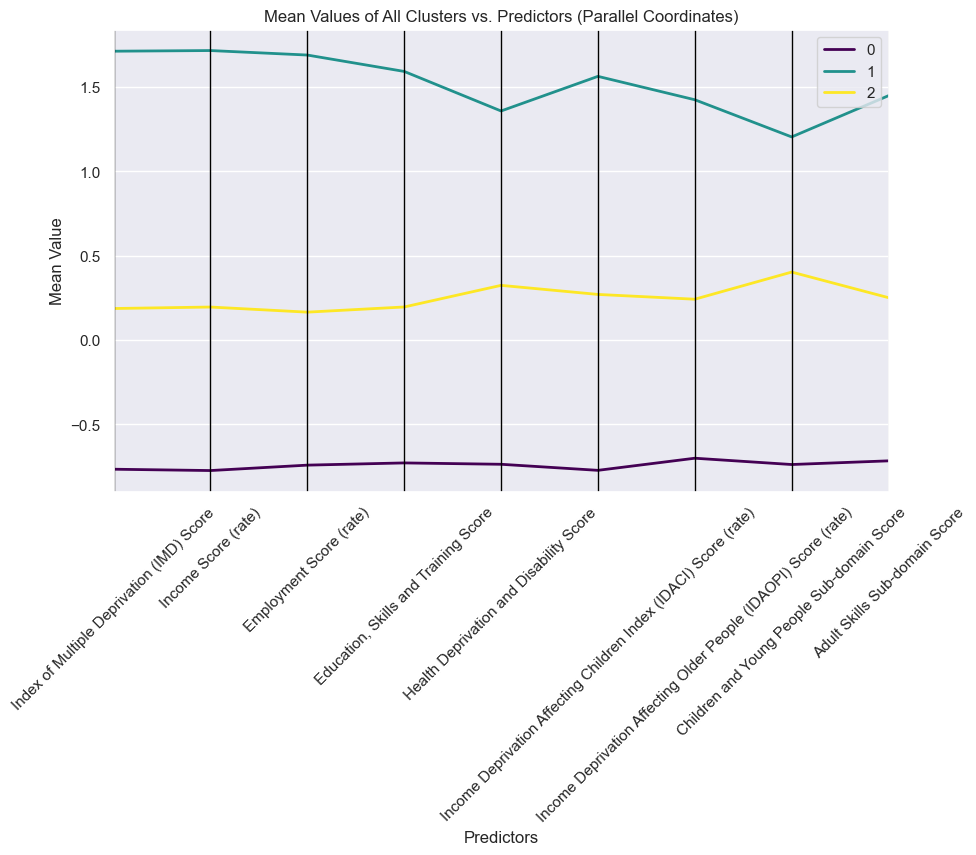

In [122]:
from pandas.plotting import parallel_coordinates

#To Calculate mean values for each predictor by cluster
mean_values = df3.groupby('cluster').mean().reset_index()

# Plotting using parallel coordinates
plt.figure(figsize=(10, 6))  # Adjust size if needed
parallel_coordinates(mean_values, 'cluster', colormap='viridis', linewidth=2)
plt.xlabel('Predictors')
plt.ylabel('Mean Value')
plt.title('Mean Values of All Clusters vs. Predictors (Parallel Coordinates)')
plt.xticks(rotation=45)
plt.legend(loc='upper right')
plt.grid(True)
plt.show()

In [123]:
#To Calculate the mean price for each cluster
cluster_means = df_filtered.groupby('cluster')['Price'].mean().reset_index()
print(cluster_means)

   cluster         Price
0        0  66977.301260
1        1  35607.864376
2        2  49095.212848


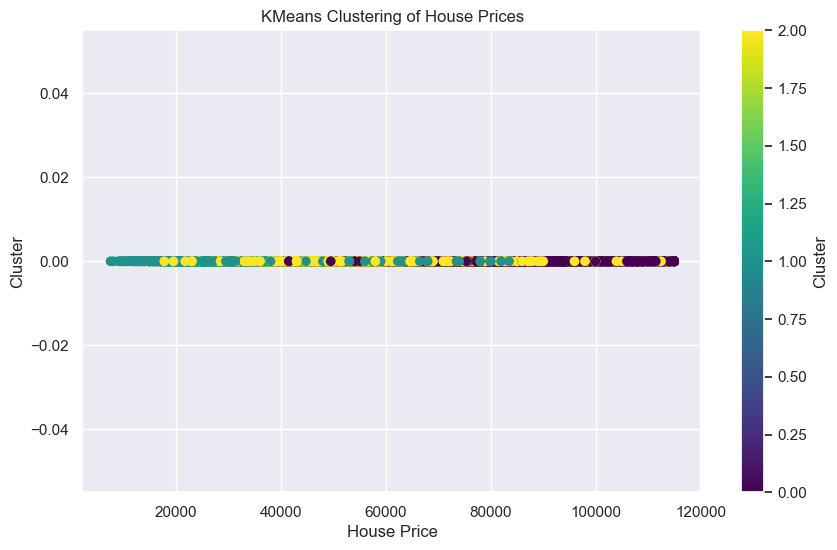

In [124]:
#To Plot the clusters
plt.figure(figsize=(10, 6))
plt.scatter(df_filtered['Price'], [0] * len(df_filtered), c=clusters, cmap='viridis')
plt.xlabel('House Price')
plt.ylabel('Cluster')
plt.title('KMeans Clustering of House Prices')
plt.colorbar(label='Cluster')
plt.show()

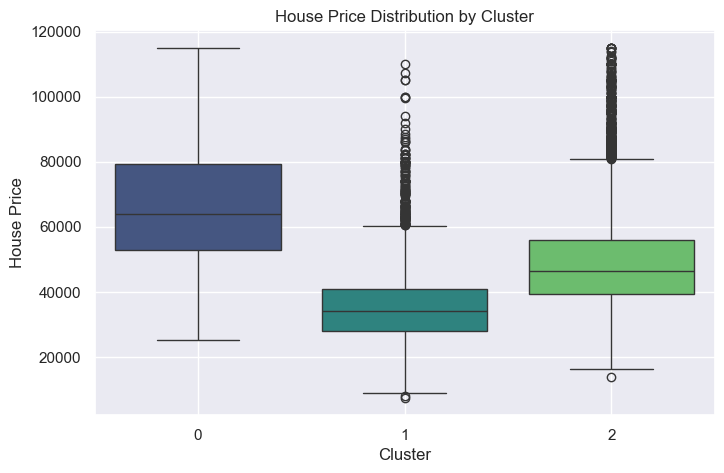

In [125]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have a DataFrame df with 'house_price' and 'cluster' columns
plt.figure(figsize=(8, 5))
sns.boxplot(x='cluster', y='Price', data=df_filtered, palette='viridis')
plt.xlabel('Cluster')
plt.ylabel('House Price')
plt.title('House Price Distribution by Cluster')
plt.grid(True)
plt.show()

### Regression Analyis for the Deprivation Variable

In [126]:
colss= ['Index of Multiple Deprivation (IMD) Score',
       'Health Deprivation and Disability Score',
       'Income Deprivation Affecting Children Index (IDACI) Score (rate)',
       'Income Deprivation Affecting Older People (IDAOPI) Score (rate)']

In [127]:
# Initialize the StandardScaler
scaler = StandardScaler()

# Standardize the selected columns while retaining the column names
df2_standardized = pd.DataFrame(scaler.fit_transform(df_filtered[colss]), columns=colss)

# concat the dataframe with the price column
df2 = pd.concat([df_filtered['Price'], df2_standardized], axis=1)

# Print the standardized DataFrame with column names
df2.head()

,Price,Index of Multiple Deprivation (IMD) Score,Health Deprivation and Disability Score,Income Deprivation Affecting Children Index (IDACI) Score (rate),Income Deprivation Affecting Older People (IDAOPI) Score (rate)
0,34750.0,1.113080,1.486297,1.219096,1.156463
1,25000.0,2.716988,1.994361,3.239181,0.469399
2,27000.0,1.574119,1.459621,1.596388,0.603460
3,44500.0,1.569052,1.635443,1.950099,0.838067
4,22000.0,2.445121,1.649993,2.374553,2.061377


In [128]:
# Separate dependent variable and independent variables
X2 = df2.drop('Price', axis=1)
y2 = df2['Price']

In [129]:
# Split the data into training and testing sets for standardized dataset
X_train_s2, X_test_s2, y_train_s2, y_test_s2 = train_test_split(X2, y2, test_size=0.2, random_state=42)

In [130]:
X_1 = sm.add_constant(X_train_s2)  #  a constant for the intercept term

# Fit the regression model
model = sm.OLS(y_train_s2, X_train_s2).fit()

# Print out the summary
print(model.summary())

                                 OLS Regression Results                                
Dep. Variable:                  Price   R-squared (uncentered):                   0.053
Model:                            OLS   Adj. R-squared (uncentered):              0.052
Method:                 Least Squares   F-statistic:                              327.8
Date:                Thu, 25 Apr 2024   Prob (F-statistic):                   5.25e-275
Time:                        13:18:45   Log-Likelihood:                     -2.9247e+05
No. Observations:               23641   AIC:                                  5.849e+05
Df Residuals:                   23637   BIC:                                  5.850e+05
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
                                                                       coef    std err          t      P>|t|      [0.025

In [131]:
# Ridge Regression for deprivation
#To adjust the regularization strength (alpha) as needed
ridge_model = Ridge(alpha=10)  
ridge_model.fit(X_train_s2, y_train_s2)

# Displaying the model summary
print("Ridge Regression Model Summary:")
print(f"Intercept: {ridge_model.intercept_}")
print("Coefficients:")
coefficients_df = pd.DataFrame({
    'Variable': X_train_s2.columns,
    'Coefficient': ridge_model.coef_
})
print(coefficients_df)

# Evaluating the model
y_pred = ridge_model.predict(X_test_s2)
rmse = mean_squared_error(y_test_s2, y_pred, squared=False)
print(f"Root Mean Squared Error (RMSE): {rmse}")

# Calculate the R-squared value
r_squared = r2_score(y_test_s2, y_pred)

print(f"R-squared value: {r_squared}")

Ridge Regression Model Summary:
Intercept: 55241.383188421154
Coefficients:
                                            Variable   Coefficient
0          Index of Multiple Deprivation (IMD) Score  -1395.388683
1            Health Deprivation and Disability Score -12428.403798
2  Income Deprivation Affecting Children Index (I...  -1011.884912
3  Income Deprivation Affecting Older People (IDA...    982.203545
Root Mean Squared Error (RMSE): 14686.571412485499
R-squared value: 0.47021325720116536


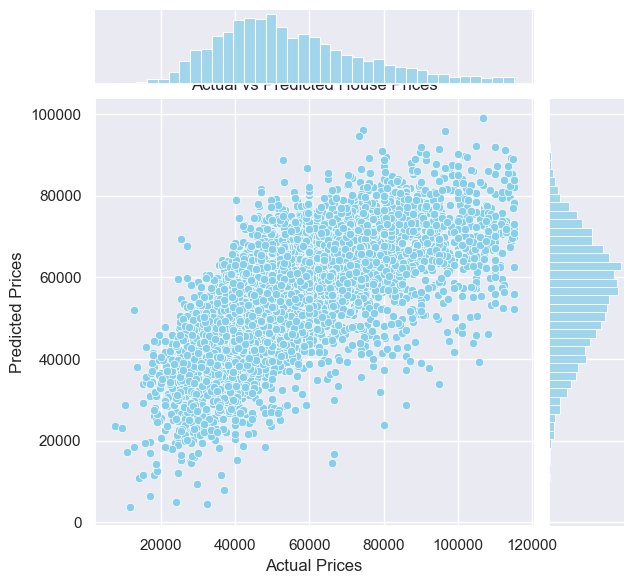

In [132]:
# Create a jointplot
sns.set(style="darkgrid")
sns.jointplot(x=y_test_s2, y=y_pred, kind="scatter", color="skyblue")


# Add labels and title
plt.xlabel('Actual Prices')
plt.ylabel('Predicted Prices')
plt.title('Actual vs Predicted House Prices')

# Show the plot
plt.show()